# NIRCam PSF Fitting

This notebook attempts to fit the NIRCam PSF using multiple Gaussian functions and a window in Fourier space.

The notebook requires numpy, matplotlib, tensorflow, tensorflow_probability, webbpsf, astropy.io fits. A path environmental variable also needs to be set.

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_probability as tfp
import os
!export WEBBPSF_PATH=/data/groups/comp-astro/jades/webbpsf-data 
os.environ["WEBBPSF_PATH"] = "/data/groups/comp-astro/jades/webbpsf-data"
import webbpsf
from astropy.io import fits
tfd = tfp.distributions

**WARNING**: LOCAL JWST PRD VERSION PRDOPSSOC-044 DOESN'T MATCH THE CURRENT ONLINE VERSION PRDOPSSOC-045
Please consider updating pysiaf, e.g. pip install --upgrade pysiaf or conda update pysiaf


In [3]:
!hostname

gpu028


### Load NIRCam PSF

In [4]:
nc = webbpsf.NIRCam()
#nc.filter = 'F200W'
nc.filter = 'F444W'
psf = nc.calc_psf(detector_oversample=1,fft_oversample=4,fov_arcsec=20.0)
#plt.imshow(psf[0].data)
#webbpsf.display_psf(psf)
data_F200W = psf[0].data

In [5]:
print(webbpsf.conf.default_fov_arcsec)

5.0


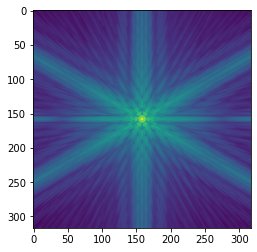

In [6]:
plt.imshow(np.log10(data_F200W))

### Define Loss and Optimizer Functions

In [7]:
# Loss function
loss_fn = tf.keras.losses.MeanSquaredError(reduction=tf.keras.losses.Reduction.SUM)

#Adam or SGM Optimizer
#optimizer = tf.optimizers.SGD(learning_rate=0.0001)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

### Define MSE TF Functions

In [8]:
#define mse
@tf.function
def mse(y_true_in, y_pred_in):
    return loss_fn(y_true=y_true_in,y_pred=y_pred_in)
#define mse in log
@tf.function
def mse_log(y_true_in, y_pred_in):
    return loss_fn(y_true=np.log10(y_true_in),y_pred=np.log10(y_pred_in))

### Define grid positions

In [9]:
def gridxy(nx=161,ny=161):
    xl = np.arange(nx,dtype=np.float32)
    yl = np.arange(ny,dtype=np.float32)
    x,y = np.meshgrid(xl,yl)
    xy = np.dstack((x,y))
    return xy

### Compute FFT of PSF

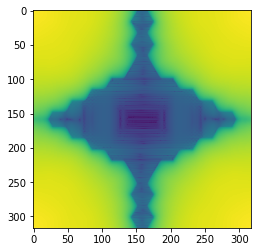

In [10]:
data_F200W_fft = np.absolute(np.fft.fft2(data_F200W))
plt.imshow(np.log10(data_F200W_fft))

### Perform three gaussian fit to PSF with Configuration and Fourier Space MSE loss with Tukey FFT Filter

In [11]:
nx = data_F200W.shape[0]
ny = data_F200W.shape[1]
#initialize xy grid
xy = gridxy(nx=nx,ny=ny)

#Epoch 9000 | Loss 0.0004640268415721366 a_0:1.3175196647644043 a_1:0.8137475848197937 a_2:0.26381099224090576
#Epoch 9000 | Loss 0.0004640268415721366 s_x_a:0.8608774542808533 s_y_a:0.8645910620689392 s_x_b:6.919021129608154 s_y_b:6.316895008087158  s_2_x:20.22382354736328 s_2_y:20.15462303161621
#Epoch 9000 | Loss 0.0004640268415721366 t_a:0.13926561176776886
#Epoch 9000 | Loss 0.0004640268415721366 sum model:0.9961426258087158 sum:0.9840865672496912

#Epoch 10000 | Loss 0.00017353625741170254 a_0:1.3587886095046997 a_1:0.7991504073143005 a_2:0.11792205274105072
#Epoch 10000 | Loss 0.00017353625741170254 s_x_a:1.1070048809051514 s_y_a:1.0063364505767822 s_x_b:7.243698596954346 s_y_b:6.162914752960205  s_2_x:20.59847640991211 s_2_y:19.640581130981445
#Epoch 10000 | Loss 0.00017353625741170254 t_a:0.09996941685676575 t_b:0.9590688347816467
#Epoch 10000 | Loss 0.00017353625741170254 sum model:1.288509726524353 sum:0.9669125841988307

#sig x
a_0 = tf.Variable(1.3587886095046997, name='a_0')
a_1 = tf.Variable(0.7991504073143005, name='a_1')
a_2 = tf.Variable(0.11792205274105072, name='a_2')


sig_0_x  = tf.Variable(1.1070048809051514,  name='sig_0_x')                       # 
sig_0_y  = tf.Variable(1.0063364505767822,  name='sig_0_y')
sig_1_x  = tf.Variable(7.243698596954346,   name='sig_1_x')                       # 
sig_1_y  = tf.Variable(6.162914752960205,   name='sig_1_y')
sig_2_x  = tf.Variable(20.59847640991211,   name='sig_2_x')                       # 
sig_2_y  = tf.Variable(19.640581130981445,   name='sig_2_y')
t_a      = tf.Variable(0.09996941685676575, name='t_a')
t_b      = tf.Variable(0.9590688347816467, name='t_b') #ratio of semimajor to semiminor axes of filter


#scale between configuration and log fourier losses
scale = 1.0e-6


mu_x_const = 0.5*(nx-1)
mu_y_const = 0.5*(ny-1)


#define model
@tf.function
def mvn_one_fit(x):
    mu = [mu_x_const,mu_y_const]
    sigma_a = [sig_x,sig_y]
    gmvn_a = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_a)
    return gmvn_a.prob(x)#+gmvn_b.prob(x)

#define model
@tf.function
def mvn_two_fit(x):
    mu = [mu_x_const,mu_y_const]
    sigma_0 = [sig_0_x,sig_0_y]
    sigma_1 = [sig_1_x,sig_1_y]

    gmvn_0 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_0)
    gmvn_1 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_1)

    return gmvn_0.prob(x)+gmvn_1.prob(x)

#define model
@tf.function
def mvn_three_fit(x):
    mu = [mu_x_const,mu_y_const]
    sigma_0 = [sig_0_x,sig_0_y]
    sigma_1 = [sig_1_x,sig_1_y]
    sigma_2 = [sig_2_x,sig_2_y]
    gmvn_0 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_0)
    gmvn_1 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_1)
    gmvn_2 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_2)
    return tf.math.abs(a_0)*gmvn_0.prob(x)+tf.math.abs(a_1)*gmvn_1.prob(x)+tf.math.abs(a_2)*gmvn_2.prob(x)



def tukey_trans(fx,a,lam):
    return 0.5*(1-tf.math.cos((np.pi*fx/(a*lam) - np.pi/a) ))
    

    
def tukey_calc(x,ta):
    # Def 4.3 of 1901.04365    
    lam = mu_x_const-1.
    al = (1.0-t_a)*lam
    fx = tf.abs(x)
    y = tf.zeros(x.shape)
    
    #inner bump
    #xs = x[fx<al]
    one_index = tf.math.less(fx,al)
    y = tf.where(one_index,tf.ones(x.shape),tf.zeros(x.shape))

    #transition
    and_index = tf.math.less_equal(fx,lam)&tf.math.greater_equal(fx,al)
    y_trans = tf.where(and_index,tukey_trans(fx,ta,lam),y)

    #result
    return y_trans


#tukey filter
@tf.function
def tukey(x):
    nx = x.shape[0]
    ny = x.shape[1]
    ta = t_a
    xx = x#.numpy()
    #return tukey_calc((xx[:,:,0]**2 + xx[:,:,1]**2)**0.5,ta) + tukey_calc(((xx[:,:,0]-nx)**2 + xx[:,:,1]**2)**0.5,ta) + tukey_calc((xx[:,:,0]**2 + (xx[:,:,1]-ny)**2)**0.5,ta) + tukey_calc(((xx[:,:,0]-nx)**2 + (xx[:,:,1]-ny)**2)**0.5,ta)
    x0 = tf.math.sqrt(tf.math.pow(x[:,:,0],2) + tf.math.pow(x[:,:,1]/t_b,2) ) 
    x1 = tf.math.sqrt(tf.math.pow(nx-1-x[:,:,0],2) + tf.math.pow(x[:,:,1]/t_b,2) ) 
    x2 = tf.math.sqrt(tf.math.pow(x[:,:,0]   ,2) + tf.math.pow((ny-1-x[:,:,1])/t_b,2) ) 
    x3 = tf.math.sqrt(tf.math.pow(nx-1-x[:,:,0],2) + tf.math.pow((ny-1-x[:,:,1])/t_b,2) ) 

    t_real = tukey_calc(x0,ta) + tukey_calc(x1,ta) + tukey_calc(x2,ta) + tukey_calc(x3,ta)
    
    return t_real/tf.math.reduce_max(t_real)


loss_fn = tf.keras.losses.MeanSquaredError(reduction=tf.keras.losses.Reduction.SUM)

#define mse
@tf.function
def mse(y_true_in, y_pred_in):
    return loss_fn(y_true=y_true_in,y_pred=y_pred_in)

#SGD Optimizer
#optimizer = tf.optimizers.SGD(learning_rate=0.0001)
#optimizer = tf.optimizers.SGD(learning_rate=0.0001)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
#optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
#optimizer = tf.keras.optimizers.Adam(learning_rate=0.01)
#optimizer = tf.keras.optimizers.Adam(learning_rate=0.003)



#flag_train = False
flag_train = True
if(flag_train):
    #start training
    epochs = 10000
    display_step = 1000
    for epoch in range(epochs):
    
        #monitor training / display steps
        if((epoch%display_step)==0):
            pred = mvn_three_fit(xy)
            tukey_filter = tukey(xy)
            pred_fft = tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred)))
            pred_fft_tuk = tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)
            pred = tf.math.abs(tf.signal.ifft2d(tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)))
            pred *= tf.math.reduce_sum(tf.cast(data_F200W[60:100,60:100],tf.float32))/tf.math.reduce_sum(pred[60:100,60:100])
            pred_fft = tf.math.abs(tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred))))
            loss = mse(pred, data_F200W) + scale*mse(tf.math.log(pred_fft), tf.math.log(data_F200W_fft))
            loss += mse(tf.math.log(pred_fft[:,0]),tf.math.log(data_F200W_fft[:,0])) + mse(tf.math.log(pred_fft[0,:]),tf.math.log(data_F200W_fft[0,:])) 
            limin = int(0.5*(nx-1)) - 20
            limax = int(0.5*(nx-1)) + 20
            loss += mse(tf.math.log(pred[limin:limax,int(0.5*(nx-1))]), tf.math.log(data_F200W[limin:limax,int(0.5*(nx-1))]))
            loss += mse(tf.math.log(pred[int(0.5*(nx-1)),limin:limax]), tf.math.log(data_F200W[int(0.5*(nx-1)),limin:limax]))
            print(f"Epoch {epoch} | Loss {loss.numpy()} a_0:{a_0.numpy()} a_1:{a_1.numpy()} a_2:{a_2.numpy()}")
            print(f"Epoch {epoch} | Loss {loss.numpy()} s_x_a:{sig_0_x.numpy()} s_y_a:{sig_0_y.numpy()} s_x_b:{sig_1_x.numpy()} s_y_b:{sig_1_y.numpy()}  s_2_x:{sig_2_x.numpy()} s_2_y:{sig_2_y.numpy()}")
            print(f"Epoch {epoch} | Loss {loss.numpy()} t_a:{t_a.numpy()} t_b:{t_b.numpy()}")
            print(f"Epoch {epoch} | Loss {loss.numpy()} sum model:{(tf.math.reduce_sum(pred)).numpy()} sum:{(tf.math.reduce_sum(data_F200W)).numpy()}")


        #begin GradientTape and optimize
        with tf.GradientTape() as g:
            pred = mvn_three_fit(xy)
            tukey_filter = tukey(xy)
            pred_fft = tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred)))
            pred_fft_tuk = tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)
            pred = tf.math.abs(tf.signal.ifft2d(tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)))
            pred *= tf.math.reduce_sum(tf.cast(data_F200W[60:100,60:100],tf.float32))/tf.math.reduce_sum(pred[60:100,60:100])
            pred_fft = tf.math.abs(tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred))))
            loss = mse(pred, data_F200W) + scale*mse(tf.math.log(pred_fft), tf.math.log(data_F200W_fft)) 
            loss += mse(tf.math.log(pred_fft[:,0]),tf.math.log(data_F200W_fft[:,0])) + mse(tf.math.log(pred_fft[0,:]),tf.math.log(data_F200W_fft[0,:])) 
            limin = int(0.5*(nx-1)) - 20
            limax = int(0.5*(nx-1)) + 20
            loss += mse(tf.math.log(pred[limin:limax,int(0.5*(nx-1))]), tf.math.log(data_F200W[limin:limax,int(0.5*(nx-1))]))
            loss += mse(tf.math.log(pred[int(0.5*(nx-1)),limin:limax]), tf.math.log(data_F200W[int(0.5*(nx-1)),limin:limax]))

#plt.plot(np.log10(np.absolute(data_F200W_fft[:,0])),label='NRC(x)')
#plt.plot(np.log10(np.absolute(data_F200W_fft[0,:])),label='NRC(y)')
#plt.plot(np.log10(np.absolute(pred_fft[:,0])),label='pred(x)')
#plt.plot(np.log10(np.absolute(pred_fft[0,:])),label='pred(y)')
#plt.legend()
#imin = int(0.5*(nx-1)) - 20
#imax = int(0.5*(nx-1)) + 20
#plt.plot(np.log10(data_F200W[int(0.5*(nx-1)),imin:imax]),label='NRC(x)')
#plt.plot(np.log10(pred[int(0.5*(nx-1)),imin:imax]),label='pred(x)')
#plt.plot(np.log10(data_F200W[imin:imax,int(0.5*(nx-1))]),label='NRC(y)')
#plt.plot(np.log10(pred[imin:imax,int(0.5*(nx-1))]),label='pred(y)')
#plt.plot(np.log10(pmvn[imin:imax,int(0.5*(nx-1))]/np.sum(pmvn)),label='gauss(x)')
#plt.legend()

        #compute gradients
        gradients = g.gradient(loss, [a_0,a_1,a_2,sig_0_x,sig_0_y,sig_1_x,sig_1_y,sig_2_x,sig_2_y,t_a,t_b])

        #update parameters
        optimizer.apply_gradients(zip(gradients,[a_0,a_1,a_2,sig_0_x,sig_0_y,sig_1_x,sig_1_y,sig_2_x,sig_2_y,t_a,t_b]))
    
    loss = mse(pred, data_F200W) + scale*mse(tf.math.log(pred_fft), tf.math.log(data_F200W_fft))
    loss += mse(tf.math.log(pred_fft[:,0]),tf.math.log(data_F200W_fft[:,0])) + mse(tf.math.log(pred_fft[0,:]),tf.math.log(data_F200W_fft[0,:])) 
    limin = int(0.5*(nx-1)) - 20
    limax = int(0.5*(nx-1)) + 20
    loss += mse(tf.math.log(pred[limin:limax,int(0.5*(nx-1))]), tf.math.log(data_F200W[limin:limax,int(0.5*(nx-1))]))
    loss += mse(tf.math.log(pred[int(0.5*(nx-1)),limin:limax]), tf.math.log(data_F200W[int(0.5*(nx-1)),limin:limax]))
    epoch = epochs
    print(f"Epoch {epoch} | Loss {loss.numpy()} a_0:{a_0.numpy()} a_1:{a_1.numpy()} a_2:{a_2.numpy()}")
    print(f"Epoch {epoch} | Loss {loss.numpy()} s_x_a:{sig_0_x.numpy()} s_y_a:{sig_0_y.numpy()} s_x_b:{sig_1_x.numpy()} s_y_b:{sig_1_y.numpy()}  s_2_x:{sig_2_x.numpy()} s_2_y:{sig_2_y.numpy()}")
    print(f"Epoch {epoch} | Loss {loss.numpy()} t_a:{t_a.numpy()} t_b:{t_b.numpy()}")
    print(f"Epoch {epoch} | Loss {loss.numpy()} sum model:{(tf.math.reduce_sum(pred)).numpy()} sum:{(tf.math.reduce_sum(data_F200W)).numpy()}")


2022-05-05 21:35:09.414322: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-05-05 21:35:10.399322: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 30989 MB memory:  -> device: 0, name: Tesla V100-PCIE-32GB, pci bus id: 0000:3b:00.0, compute capability: 7.0
2022-05-05 21:35:10.400605: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 30989 MB memory:  -> device: 1, name: Tesla V100-PCIE-32GB, pci bus id: 0000:d8:00.0, compute capability: 7.0
[W 2022-05-05 21:35:10,810.810 tensorflow] From /cm/local/apps/python37/lib/python3.7/site-packages/tensorflow_probability/python/

Epoch 0 | Loss 38.16895945672333 a_0:1.3587886095046997 a_1:0.7991504073143005 a_2:0.11792205274105072
Epoch 0 | Loss 38.16895945672333 s_x_a:1.1070048809051514 s_y_a:1.0063364505767822 s_x_b:7.243698596954346 s_y_b:6.162914752960205  s_2_x:20.59847640991211 s_2_y:19.640581130981445
Epoch 0 | Loss 38.16895945672333 t_a:0.09996941685676575 t_b:0.9590688347816467
Epoch 0 | Loss 38.16895945672333 sum model:11.164850234985352 sum:0.9910535602999088
Epoch 1000 | Loss 25.005919737065277 a_0:1.4257903099060059 a_1:0.7278780341148376 a_2:0.15278230607509613
Epoch 1000 | Loss 25.005919737065277 s_x_a:1.018065094947815 s_y_a:0.9530588984489441 s_x_b:7.1200995445251465 s_y_b:6.176389217376709  s_2_x:20.55784797668457 s_2_y:19.68836212158203
Epoch 1000 | Loss 25.005919737065277 t_a:0.089165598154068 t_b:0.9570683836936951
Epoch 1000 | Loss 25.005919737065277 sum model:4.9019083976745605 sum:0.9910535602999088
Epoch 2000 | Loss 21.376914521737852 a_0:1.4651942253112793 a_1:0.6861920356750488 a_2:0.

1.0


__main__:1: RuntimeWarning: divide by zero encountered in log10


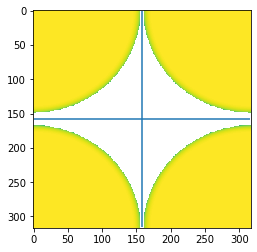

In [12]:
plt.imshow(np.log10(tukey_filter))
print(np.max(tukey_filter))
plt.hlines(0.5*(nx-1),0,nx-1)
plt.vlines(0.5*(nx-1),0,nx-1)

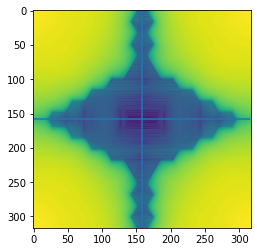

In [13]:
plt.imshow(tf.math.log(tf.math.abs(data_F200W_fft)))
plt.hlines(0.5*(nx-1),0,nx-1)
plt.vlines(0.5*(nx-1),0,nx-1)

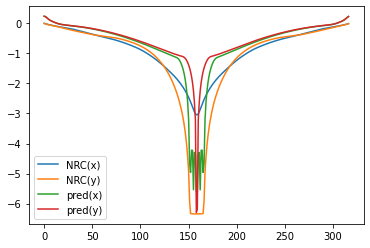

In [14]:
plt.plot(np.log10(np.absolute(data_F200W_fft[:,0])),label='NRC(x)')
plt.plot(np.log10(np.absolute(data_F200W_fft[0,:])),label='NRC(y)')
plt.plot(np.log10(np.absolute(pred_fft[:,0])),label='pred(x)')
plt.plot(np.log10(np.absolute(pred_fft[0,:])),label='pred(y)')
plt.legend()

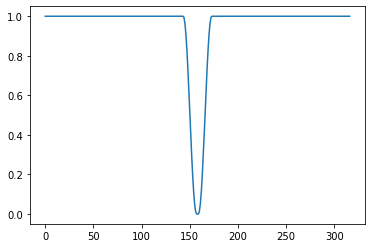

In [15]:
plt.plot(tukey_filter[0,:])

1.7195544


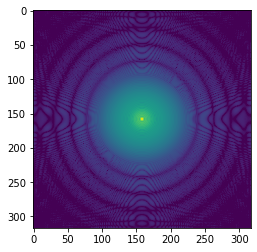

In [16]:
plt.imshow(np.log10(pred),vmin=-8.1,vmax=-0.8)
print(np.sum(pred))

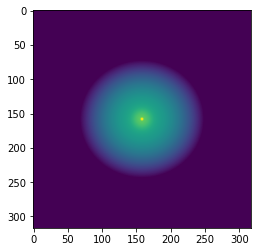

In [17]:
plt.imshow(np.log10(mvn_three_fit(xy)),vmin=-8.1,vmax=-0.8)

-9.225569416317226 -0.8963578266473058


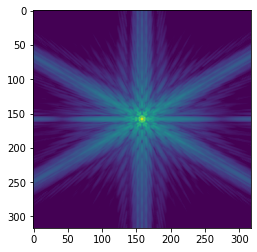

In [18]:
plt.imshow(np.log10(data_F200W),vmin=-8.1,vmax=-0.8)
print(np.min(np.log10(data_F200W)),np.max(np.log10(data_F200W)))

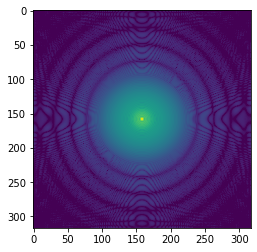

In [19]:
plt.imshow(np.log10(pred),vmin=-8.1,vmax=-0.8)

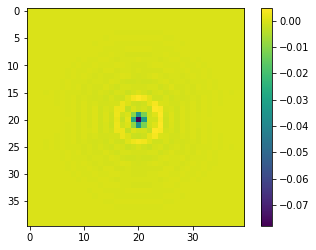

In [20]:
imin = int(0.5*(nx-1)) - 20
imax = int(0.5*(nx-1)) + 20

plt.imshow((data_F200W[imin:imax,imin:imax]-pred[imin:imax,imin:imax]))
plt.colorbar()

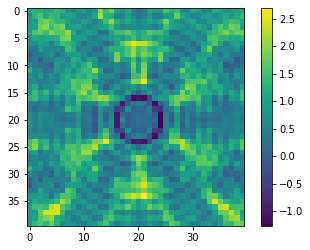

In [21]:
imin = int(0.5*(nx-1)) - 20
imax = int(0.5*(nx-1)) + 20

plt.imshow((np.log10(pred[imin:imax,imin:imax])-np.log10(data_F200W[imin:imax,imin:imax])))
plt.colorbar()

-6.798819685423754 -0.8963578266473058


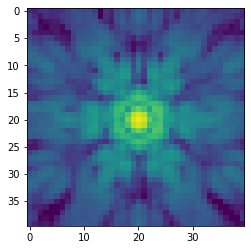

In [22]:
imin = int(0.5*(nx-1)) - 20
imax = int(0.5*(nx-1)) + 20
plt.imshow(np.log10(data_F200W[imin:imax,imin:imax]),vmin=-6.1,vmax=-0.8)
print(np.min(np.log10(data_F200W[imin:imax,imin:imax])),np.max(np.log10(data_F200W[imin:imax,imin:imax])))

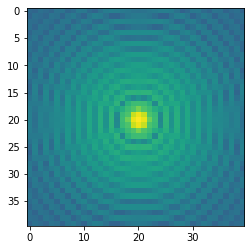

In [23]:
imin = int(0.5*(nx-1)) - 20
imax = int(0.5*(nx-1)) + 20
plt.imshow(np.log10(pred[imin:imax,imin:imax]),vmin=-6.1,vmax=-0.8)

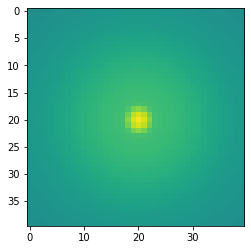

In [24]:
imin = int(0.5*(nx-1)) - 20
imax = int(0.5*(nx-1)) + 20
pmvn = mvn_three_fit(xy)
plt.imshow(np.log10(pmvn[imin:imax,imin:imax]/np.sum(pmvn)),vmin=-8.1,vmax=-0.8)


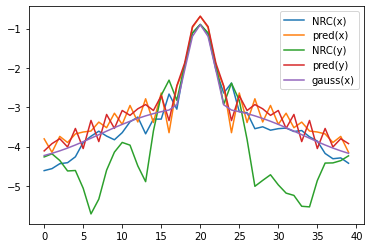

In [25]:
imin = int(0.5*(nx-1)) - 20
imax = int(0.5*(nx-1)) + 20
plt.plot(np.log10(data_F200W[int(0.5*(nx-1)),imin:imax]),label='NRC(x)')
plt.plot(np.log10(pred[int(0.5*(nx-1)),imin:imax]),label='pred(x)')
plt.plot(np.log10(data_F200W[imin:imax,int(0.5*(nx-1))]),label='NRC(y)')
plt.plot(np.log10(pred[imin:imax,int(0.5*(nx-1))]),label='pred(y)')
plt.plot(np.log10(pmvn[imin:imax,int(0.5*(nx-1))]/np.sum(pmvn)),label='gauss(x)')
plt.legend()

## Test on DC2 images

In [26]:
import sys
import os
sys.path.insert(0,'/home/brant/github/jades-sources/notebooks/')
from jades_lib import paths as jades_paths
import numpy as np
import matplotlib.pyplot as plt
from jades_utils import quicklook as jql
from astropy.io import fits

In [27]:
import jades_psfs as jpsfs

In [28]:
jpsf = jpsfs.jades_psfs()

In [29]:
jlp = jades_paths()

In [30]:
print(jlp.data_root)

/data/groups/comp-astro/jades/jades-data/


In [31]:
os.listdir(path=jlp.data_root)

['GOODS-N',
 '.dvc',
 'UDS',
 'EGS',
 'fake.dat',
 '.gitignore',
 '.git',
 'GOODS-S',
 '.dvcignore',
 'workflows.md',
 'fake.dat.dvc',
 'README.md',
 'Guitarra']

In [32]:
data_dc2 = jlp.data_root + "Guitarra/images/JWST/DC2-mosaics/v6/"

In [33]:
os.listdir(path=data_dc2)

['F410M',
 'F115W',
 'F356W',
 'F277W',
 'F150W',
 'F444W',
 'F335M',
 'F090W',
 'F200W',
 'copy_files.sh']

In [34]:
fdir_F356W = data_dc2+"F356W/"

In [35]:
os.listdir(path=fdir_F356W)

['F356W_exp.fits',
 '.gitignore',
 'readme.md',
 'F356W_err_conv.fits',
 'F356W_conv.fits.dvc',
 'F356W.png.dvc',
 'F356W_err_conv.fits.dvc',
 'F356W_err.fits.dvc',
 'F356W_err.fits',
 'F356W_exp.fits.dvc',
 'F356W.fits.dvc',
 'F356W.png',
 'README.md',
 'F356W.fits',
 'F356W_conv.fits']

In [36]:
fname_F356W_flux_fits = fdir_F356W+"F356W.fits"
fname_F356W_ferr_fits = fdir_F356W+"F356W_err.fits"

In [37]:
hdu_F356W_flux = fits.open(fname_F356W_flux_fits)
hdu_F356W_ferr = fits.open(fname_F356W_ferr_fits)

In [38]:
print(repr(hdu_F356W_flux[0].header))

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -32 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                13575                                                  
NAXIS2  =                12277                                                  
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
WCSAXES =                    2 / Number of coordinate axes                      
CRPIX1  =               6787.5 / Pixel coordinate of reference point            
CRPIX2  =               6138.5 / Pixel coordinate of reference point            
CDELT1  = -1.6666666666666E-05 / [deg] Coordinate increment at reference point  
CDELT2  = 1.66666666666666E-05 / [deg] Coordinate increment at reference point  
CUNIT1  = 'deg     '        

In [39]:
data_F356W_flux = hdu_F356W_flux[0].data
data_F356W_ferr = hdu_F356W_ferr[0].data

In [140]:
xmin = 6000
xmax = 8000
ymin = 6000
ymax = 8000
data_flux = jql.cutout(data_F356W_flux,xmin,xmax,ymin,ymax)
data_ferr = jql.cutout(data_F356W_ferr,xmin,xmax,ymin,ymax)

In [141]:
data_flux = data_flux.byteswap(inplace=True).newbyteorder()
data_ferr = data_ferr.byteswap(inplace=True).newbyteorder()

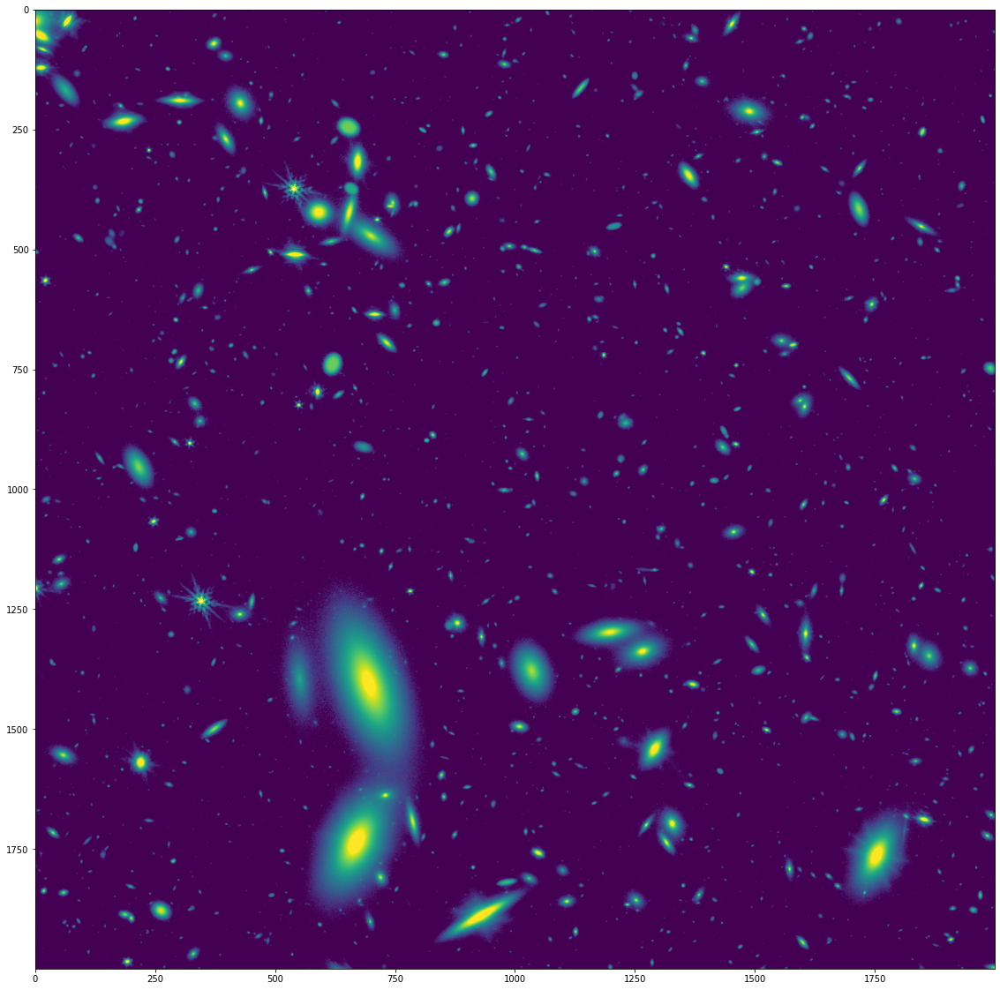

In [152]:

jql.imshow(data_flux,fnx=20,fny=20,flag_log=True)

### Show the PSF from F356W

In [48]:
#fdir_psfs="/home/brant/github/jades-sources/notebooks/psfs/sparkle/"
#fname = fdir_psfs+"psf_F356W.fits"
#hdu = fits.open(fname)
#psf_F356W = hdu[0].data
#print(psf_F356W.shape)
#jql.imshow(psf_F356W,fnx=10,fny=10,flag_log=True)
#print(psf_F356W.min(),psf_F356W.max())


#nc = webbpsf.NIRCam()
#nc.filter = 'F200W'
nc.filter = 'F356W'
hdu_F356W = nc.calc_psf(detector_oversample=1,fft_oversample=4,fov_arcsec=20.0)
psf_F356W = hdu_F356W[0].data
print(psf_F356W.shape)

(317, 317)


(317, 317)
3.9970475411011533e-10 0.18936936002005206


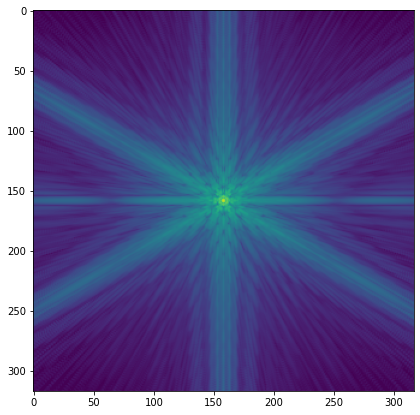

In [49]:

f = plt.figure(figsize=(7,7))
plt.imshow(np.log10(psf_F356W),vmin=-9,vmax=0)
#jql.imshow(psf_F356W,fnx=20,fny=20,flag_log=True)
print(psf_F356W.shape)
print(psf_F356W.min(),psf_F356W.max())

__main__:7: RuntimeWarning: invalid value encountered in true_divide


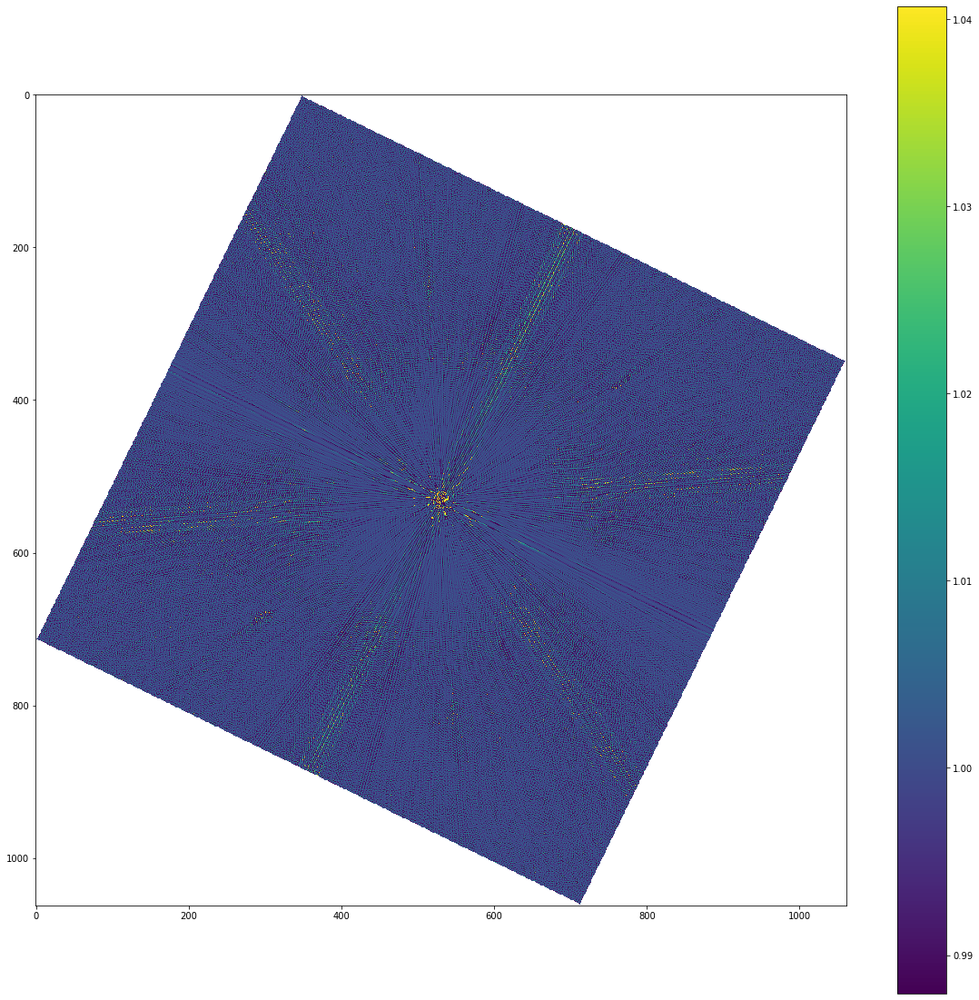

In [360]:
from scipy.ndimage.interpolation import rotate

rotated_1 = rotate(psf_F356W, angle=-26.0, order=1)
rotated_3 = rotate(psf_F356W, angle=-26.0, order=3)
rotated_5 = rotate(psf_F356W, angle=-26.0, order=5)

jql.imshow(rotated_5/rotated_3,fnx=20,fny=20,flag_log=False)
plt.colorbar()

424 424


__main__:7: RuntimeWarning: invalid value encountered in log10


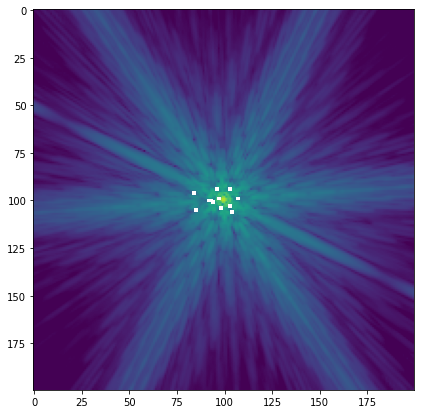

In [56]:
nxr = rotated.shape[0]
nyr = rotated.shape[1]
print(nxr,nyr)
cnxr = int(0.5*rotated.shape[0])
cnyr = int(0.5*rotated.shape[1])
f = plt.figure(figsize=(7,7))
plt.imshow(np.log10(rotated[cnxr-100:cnxr+100,cnyr-100:cnyr+100]),vmin=-8,vmax=0)

In [57]:
psf_rot = rotated[cnxr-100:cnxr+100,cnyr-100:cnyr+100].copy()
idx_nan = np.where(np.isnan(psf_rot)==True)
psf_rot[idx_nan] = 0

In [65]:
print(np.sum(psf_rot))

0.9884354915540908


### Lucy-Richardson deconvolution

Note it's important to remove any nans to prevent propagation of NaNs into the flux

In [58]:
from scipy.signal import convolve2d

d = data_flux.copy()
idx = np.where(np.isnan(d)==True)
d[idx] = 0
P = psf_rot.copy()
Pflip = np.flip(P)

ut = d.copy()

for i in range(5):
    
    print(i)
    uP_conv = convolve2d(ut,P,'same')
    
    
    
    uta = ut*convolve2d( d/(uP_conv), Pflip, 'same')
    
    ut = uta.copy()



0
1
2
3
4


In [59]:
fits.writeto("psf_F356W_rot.fits",psf_rot)
fits.writeto("data_F356W_deconvolve.fits",ut)

-2374252.7418601196 190060.5064336446


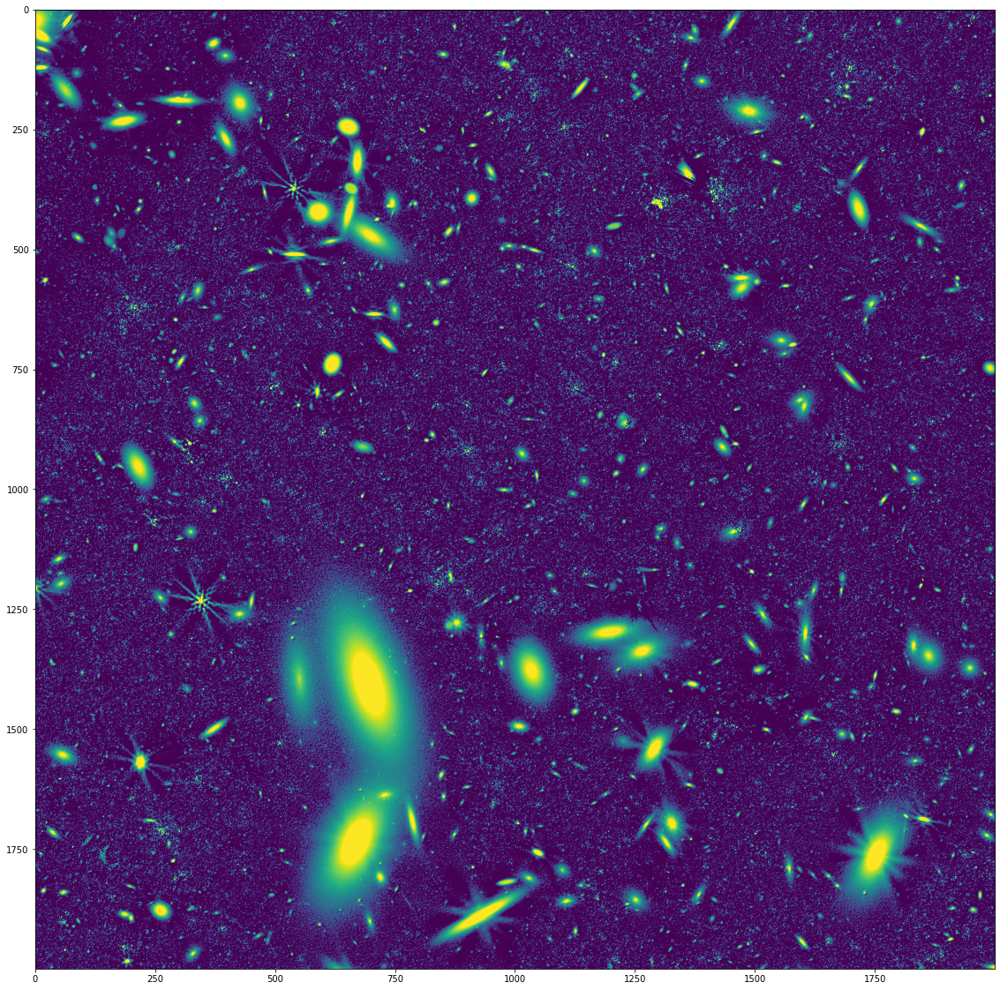

In [61]:
jql.imshow(ut,fnx=20,fny=20,flag_log=True)
print(ut.min(),ut.max())

In [63]:
print(np.nanmin(data_flux),np.nanmax(data_flux))

-0.8698509 74558.58


1.7195544


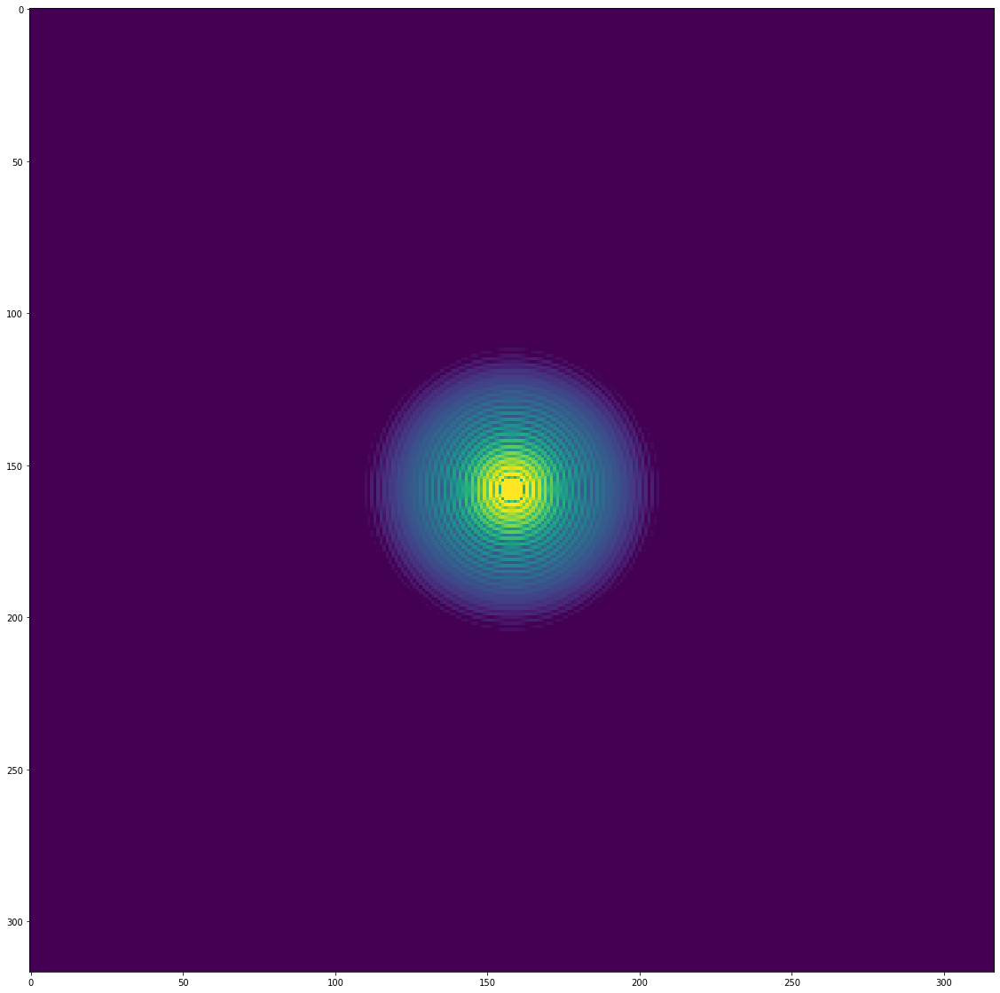

In [68]:
jql.imshow(pred.numpy(),fnx=20,fny=20,flag_log=True)
print(np.sum(pred.numpy()))

In [69]:
pred_norm = pred.numpy().copy()/np.sum(pred.numpy())

In [266]:
pred_gauss = mvn_three_fit(xy)
pred_gauss = pred_gauss.numpy()/np.sum(pred_gauss.numpy())

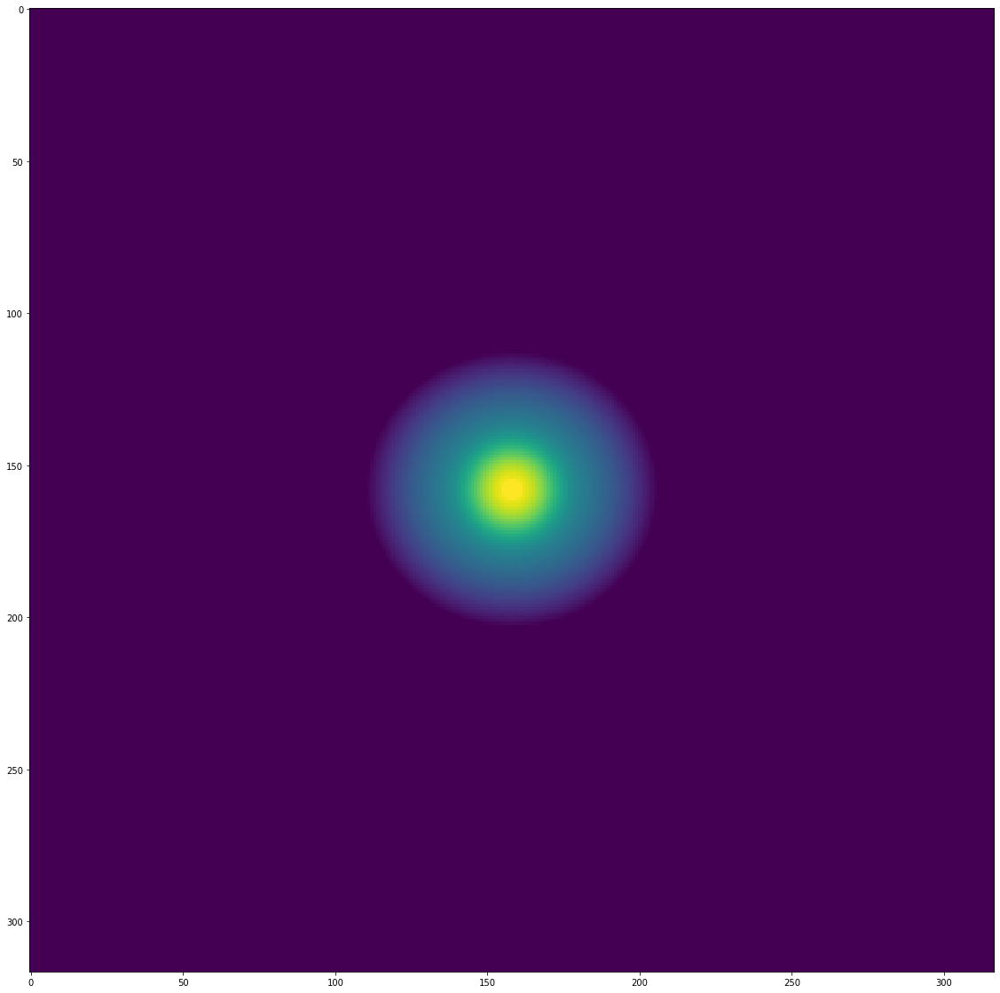

In [267]:
jql.imshow(pred_gauss,fnx=20,fny=20,flag_log=True)

In [70]:
fits.writeto("psf_pred.fits",pred_norm)


In [71]:
test = convolve2d(ut,pred_norm,'same')


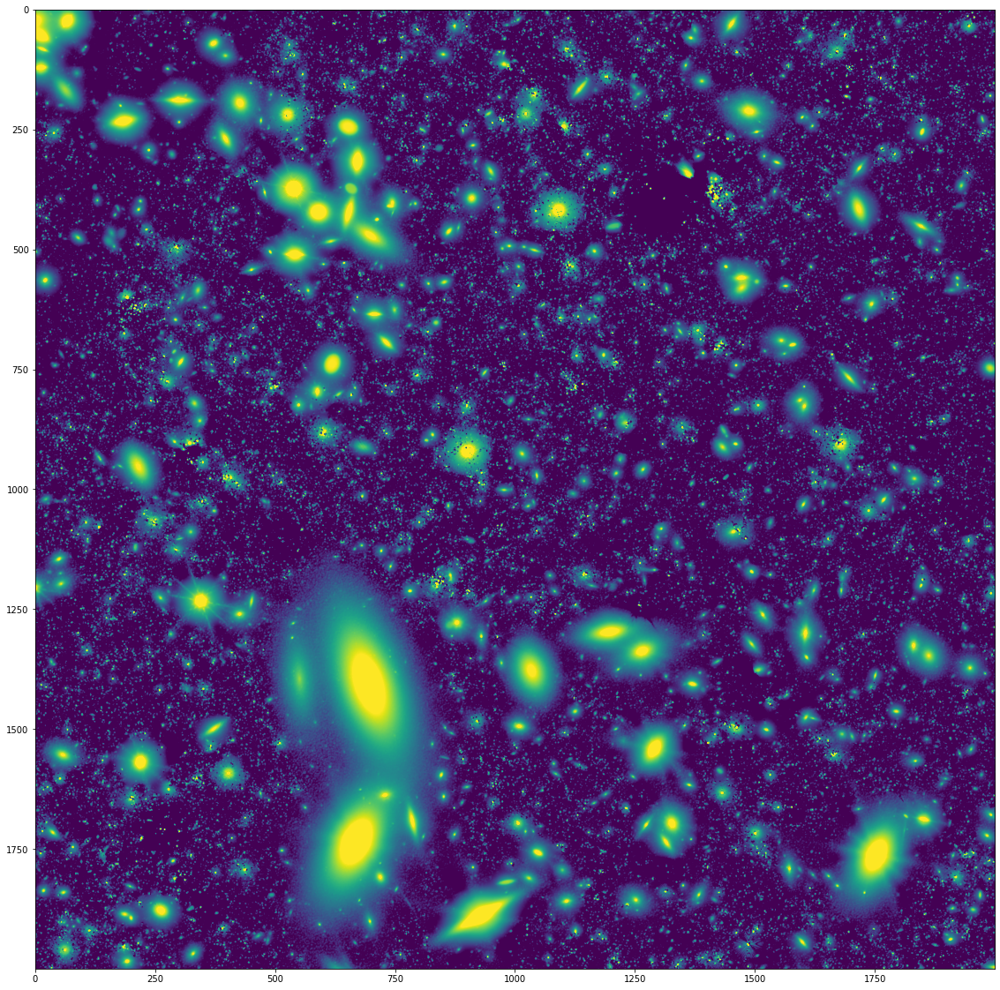

In [72]:
jql.imshow(test,fnx=20,fny=20,flag_log=True)


In [73]:
#wiener deconvolution

In [75]:
psf_rot_fft = np.fft.fft2(psf_rot)

In [77]:
g_rot_fft = np.conjugate(psf_rot_fft)/np.absolute(psf_rot_fft)**2

In [78]:
g_rot = np.fft.ifft2(g_rot_fft)

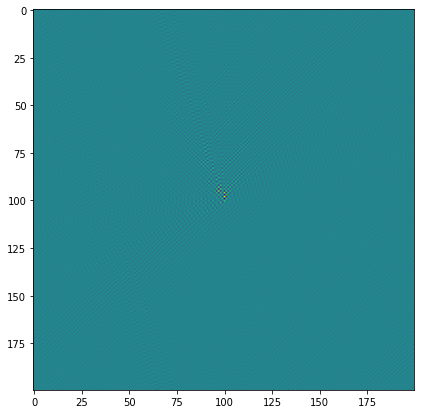

In [82]:
f = plt.figure(figsize=(7,7))
plt.imshow(np.real(g_rot))

In [83]:
wiener_test = convolve2d(data_flux.copy(),g_rot,'same')


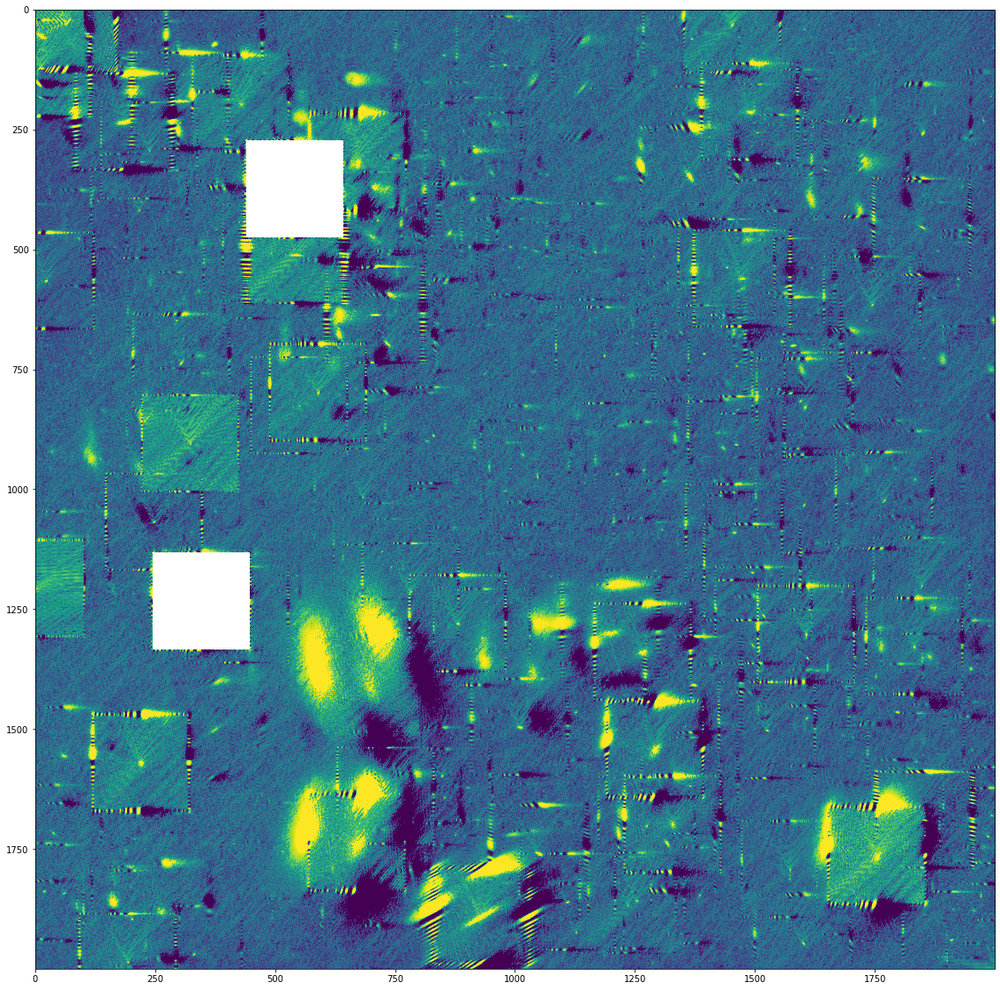

In [85]:
jql.imshow(np.real(wiener_test),fnx=20,fny=20,flag_log=True)


In [143]:
signal = data_flux.copy()
kernel = np.zeros_like(signal)
nkx = psf_rot.shape[0]
nky = psf_rot.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)

#idx = np.where(np.isnan(psf_rot))[0]
idx = np.where(np.isnan(signal))
signal[idx] = 0
#print(len(idx))

kernel[iko:iko+nkx,jko:jko+nky] += psf_rot
#kernel = np.hstack((kernel, np.zeros(len(signal) - len(kernel)))) # zero pad the kernel to same length
H = np.fft.fft2(kernel)
deconvolved = np.real(np.fft.ifft2(np.fft.fft2(signal)*np.conj(H)/(H*np.conj(H))))
#deconvolved = np.real(np.fft.ifft2(np.fft.fft2(signal)*np.conj(H)/np.absolute(H)**2))

#return deconvolved

In [144]:
print(deconvolved.min())
print(deconvolved.max())

-1501401.239199524
1851292.5223422681


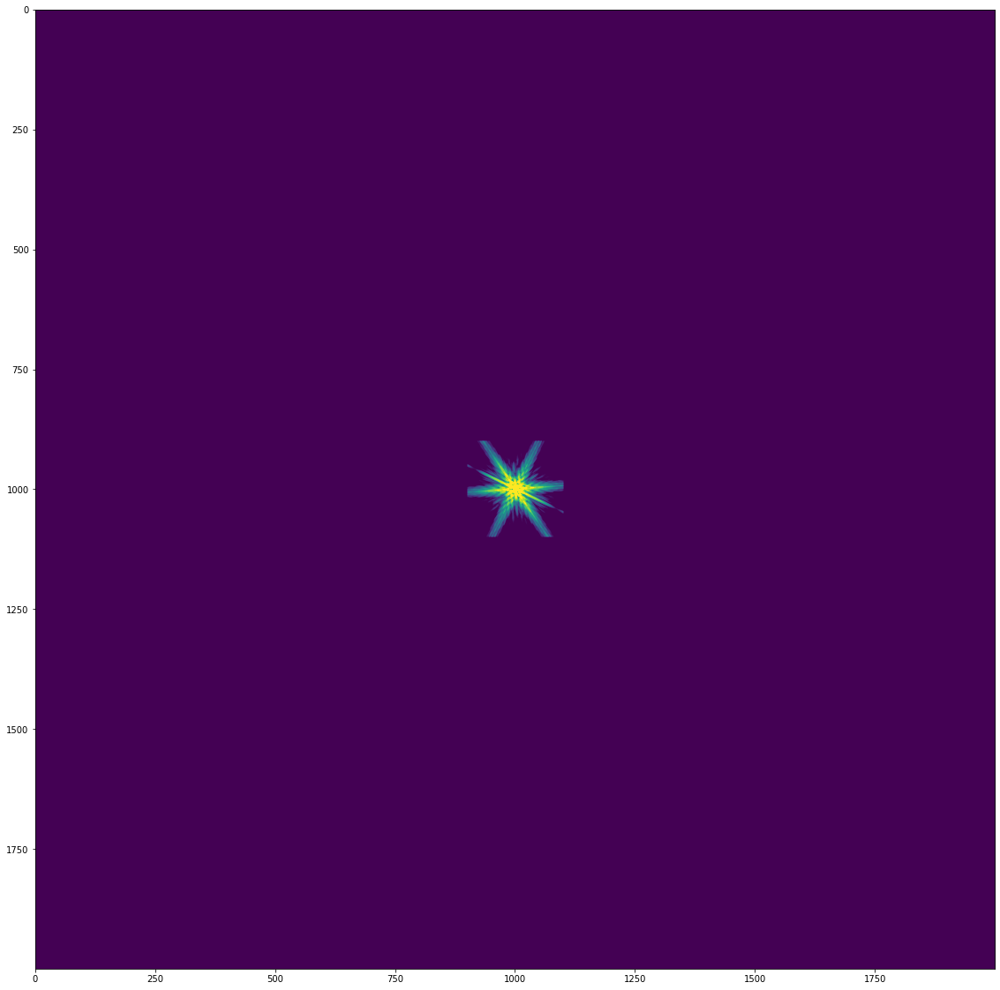

In [145]:
jql.imshow(kernel,fnx=20,fny=20,flag_log=True)


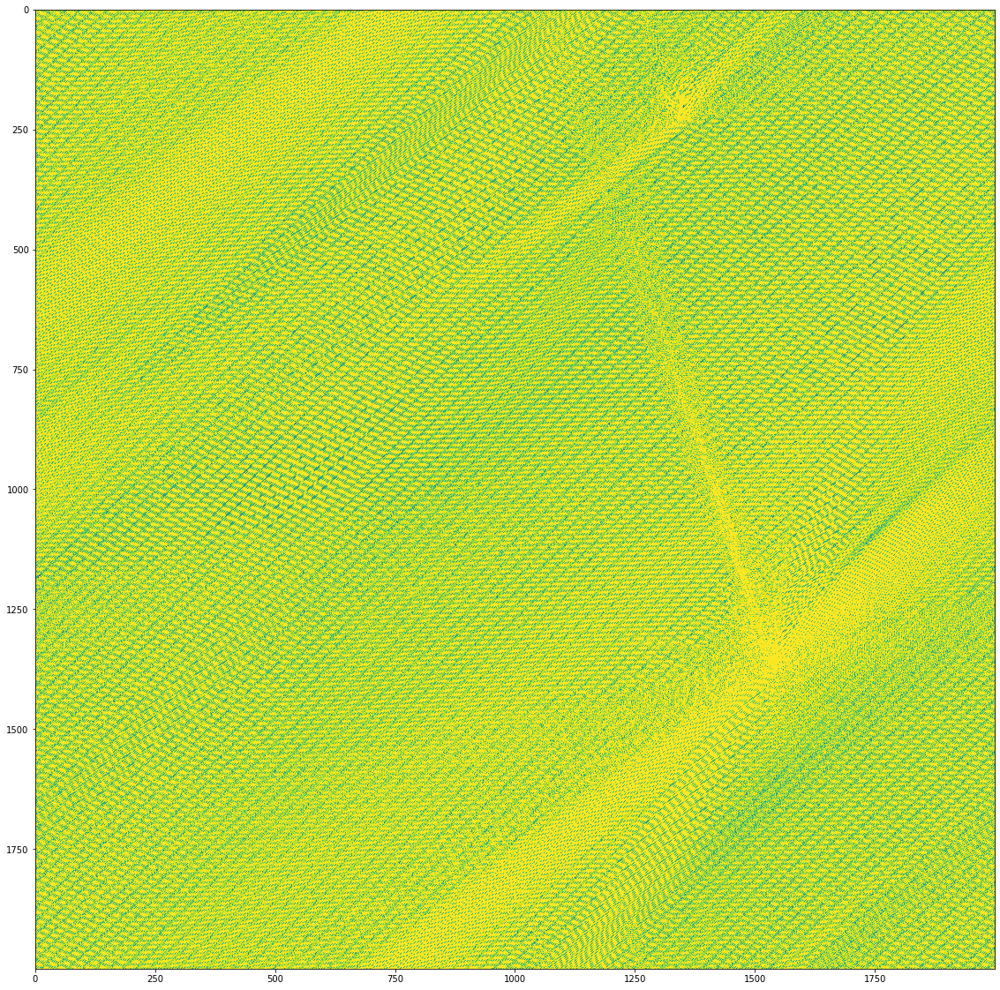

In [146]:
jql.imshow(deconvolved,fnx=20,fny=20,flag_log=True)


In [147]:
#nc = webbpsf.NIRCam()
#nc.filter = 'F200W'
nc.filter = 'F356W'
hdu_F356W = nc.calc_psf(detector_oversample=1,fft_oversample=4,fov_arcsec=50.0)
psf_F356W = hdu_F356W[0].data
print(psf_F356W.shape)

(794, 794)


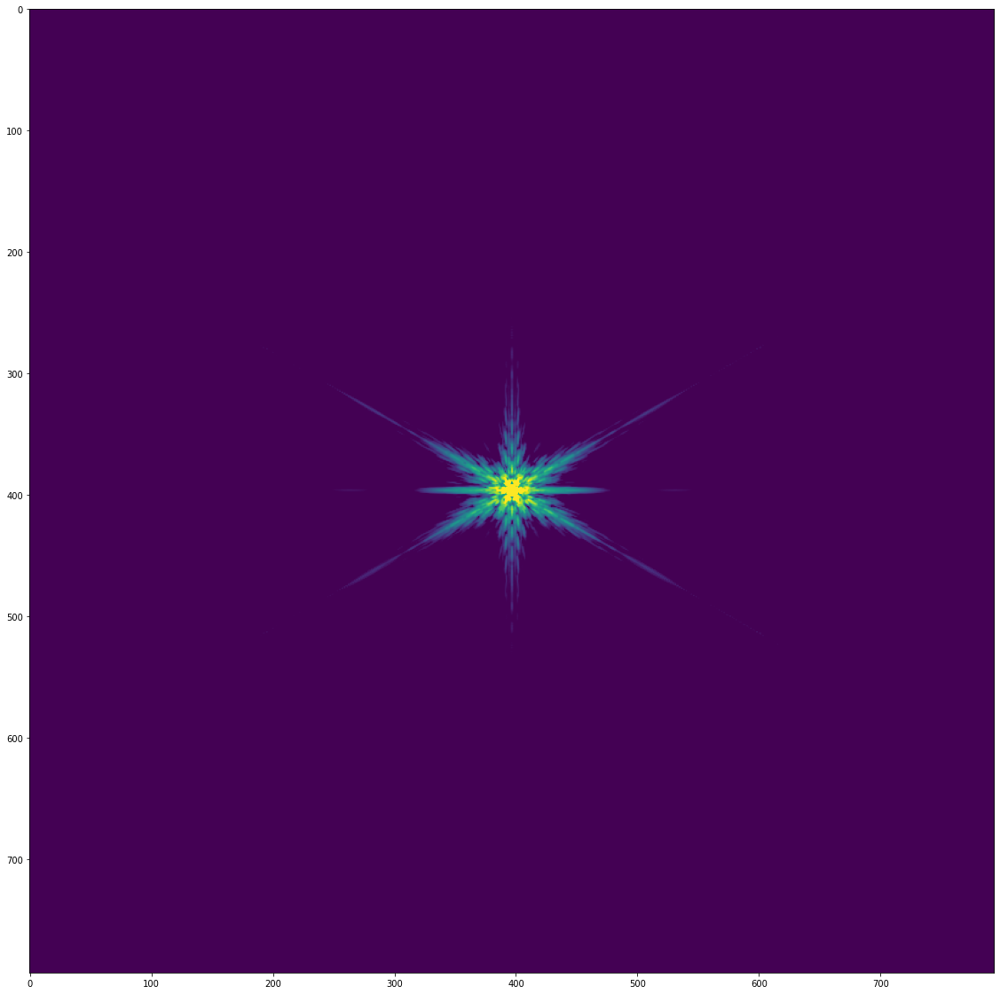

In [148]:
jql.imshow(psf_F356W,fnx=20,fny=20,flag_log=True)


In [335]:
rotated = rotate(psf_F356W, angle=-26)

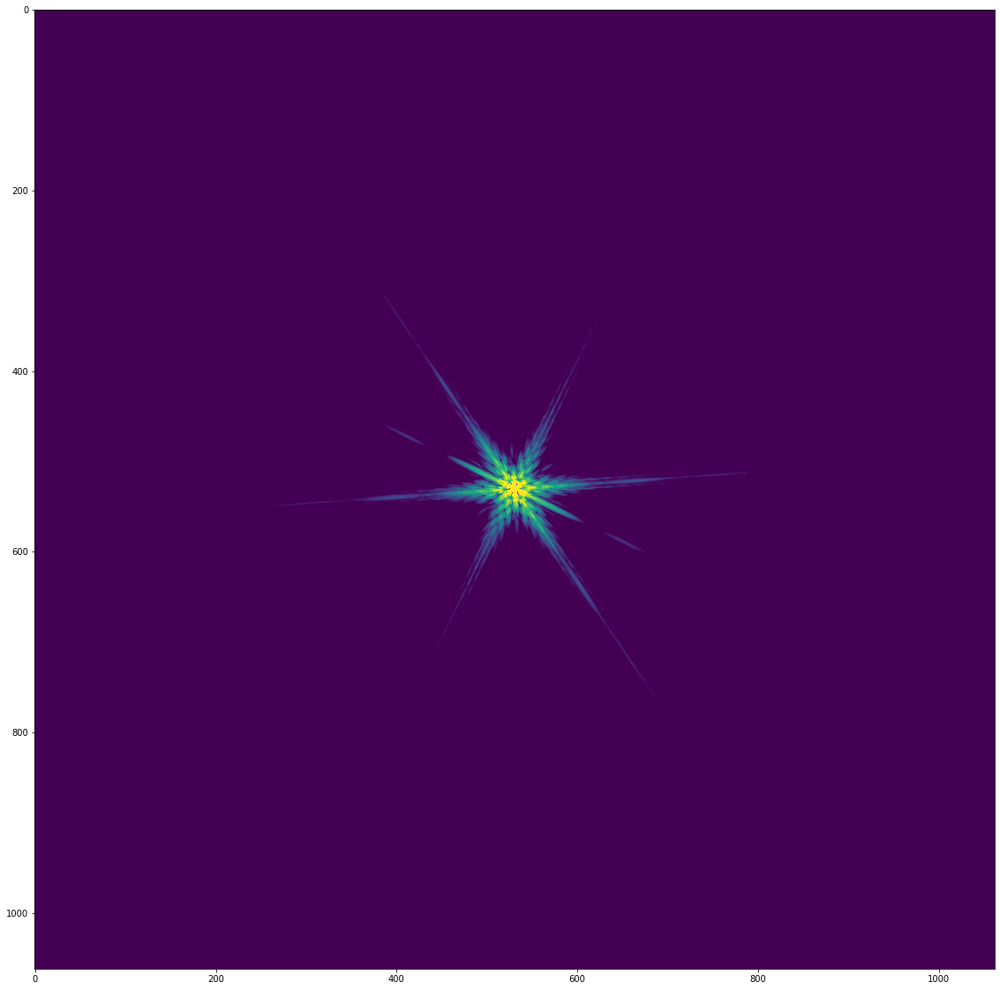

In [336]:
jql.imshow(rotated,fnx=20,fny=20,flag_log=True)


In [342]:
signal = data_flux.copy()
kernel = np.zeros_like(signal)
pkernel = np.zeros_like(signal)


nkx = rotated.shape[0]
nky = rotated.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
kernel[iko:iko+nkx,jko:jko+nky] += rotated

pred_kernel = pred.numpy().copy()
pred_kernel/=np.sum(pred_kernel)
nkx = pred_kernel.shape[0]
nky = pred_kernel.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
pkernel[iko:iko+nkx,jko:jko+nky] += pred_kernel

#idx = np.where(np.isnan(psf_rot))[0]
idx = np.where(np.isnan(signal))
signal[idx] = 0
#print(len(idx))

#signal += signal.min()

noise = 0.0001
#kernel = np.hstack((kernel, np.zeros(len(signal) - len(kernel)))) # zero pad the kernel to same length
H = np.fft.fft2(kernel)
#deconvolved = np.real(np.fft.ifft2(np.fft.fft2(signal)*np.conj(H)/(H*np.conj(H))))
deconvolved = np.real(np.fft.ifft2(np.fft.fft2(pkernel)*np.fft.fft2(signal)*np.conj(H)/(np.absolute(H)**2 + noise)))
#deconvolved = np.imag(np.fft.ifft2(np.fft.fft2(signal)*np.conj(H)/(H*np.conj(H))))
print(deconvolved.std())

22.669249612417527


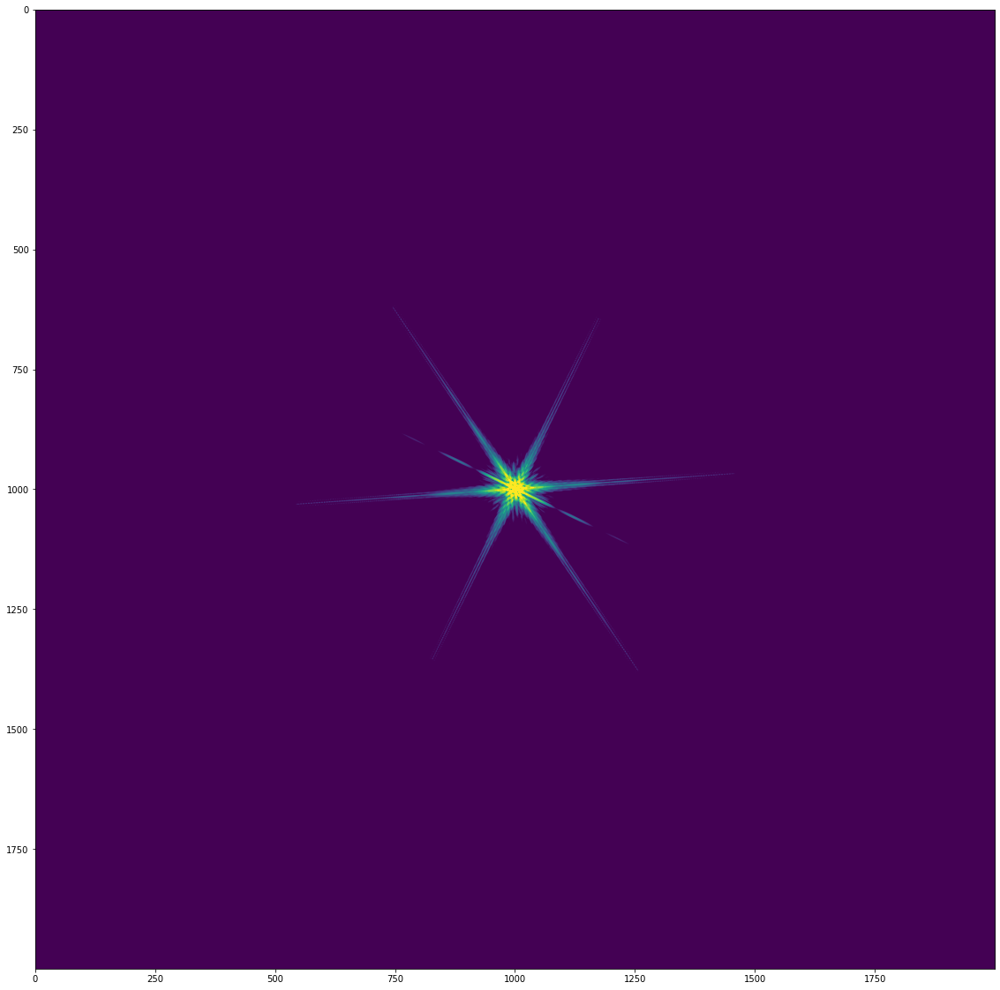

In [343]:
#jql.imshow(pred.numpy()/pred_gauss,fnx=20,fny=20,flag_log=True)
jql.imshow(kernel,fnx=20,fny=20,flag_log=True)

-3075.5492611991176
19827.1096065415
22.669249612417527


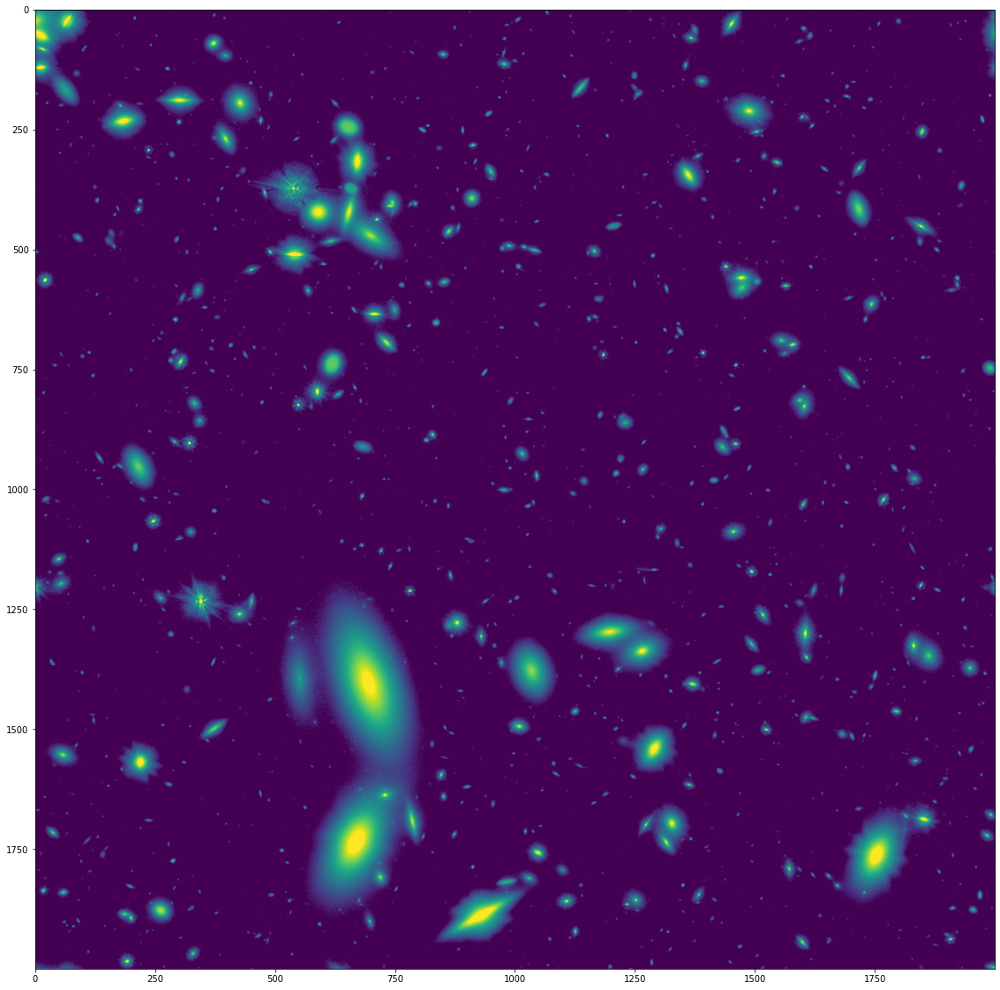

In [344]:
jql.imshow(deconvolved,fnx=20,fny=20,flag_log=True)
print(deconvolved.min())
print(deconvolved.max())
print(deconvolved.std())

## Gaussian model

In [347]:
signal = data_flux.copy()
kernel = np.zeros_like(signal)
pkernel = np.zeros_like(signal)


nkx = rotated.shape[0]
nky = rotated.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
kernel[iko:iko+nkx,jko:jko+nky] += rotated

pred_kernel = pred_gauss.copy()
nkx = pred_kernel.shape[0]
nky = pred_kernel.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
pkernel[iko:iko+nkx,jko:jko+nky] += pred_kernel

#idx = np.where(np.isnan(psf_rot))[0]
idx = np.where(np.isnan(signal))
signal[idx] = 0
#print(len(idx))

#signal += signal.min()

noise = 0.001

#kernel = np.hstack((kernel, np.zeros(len(signal) - len(kernel)))) # zero pad the kernel to same length
H = np.fft.fft2(kernel)
#deconvolved = np.real(np.fft.ifft2(np.fft.fft2(signal)*np.conj(H)/(H*np.conj(H))))
deconvolved_gauss = np.real(np.fft.ifft2(np.fft.fft2(pkernel)*np.fft.fft2(signal)*np.conj(H)/(np.absolute(H)**2+noise)))
#deconvolved = np.imag(np.fft.ifft2(np.fft.fft2(signal)*np.conj(H)/(H*np.conj(H))))

-3428.0224718237573
19805.980916506887
22.542565887092678


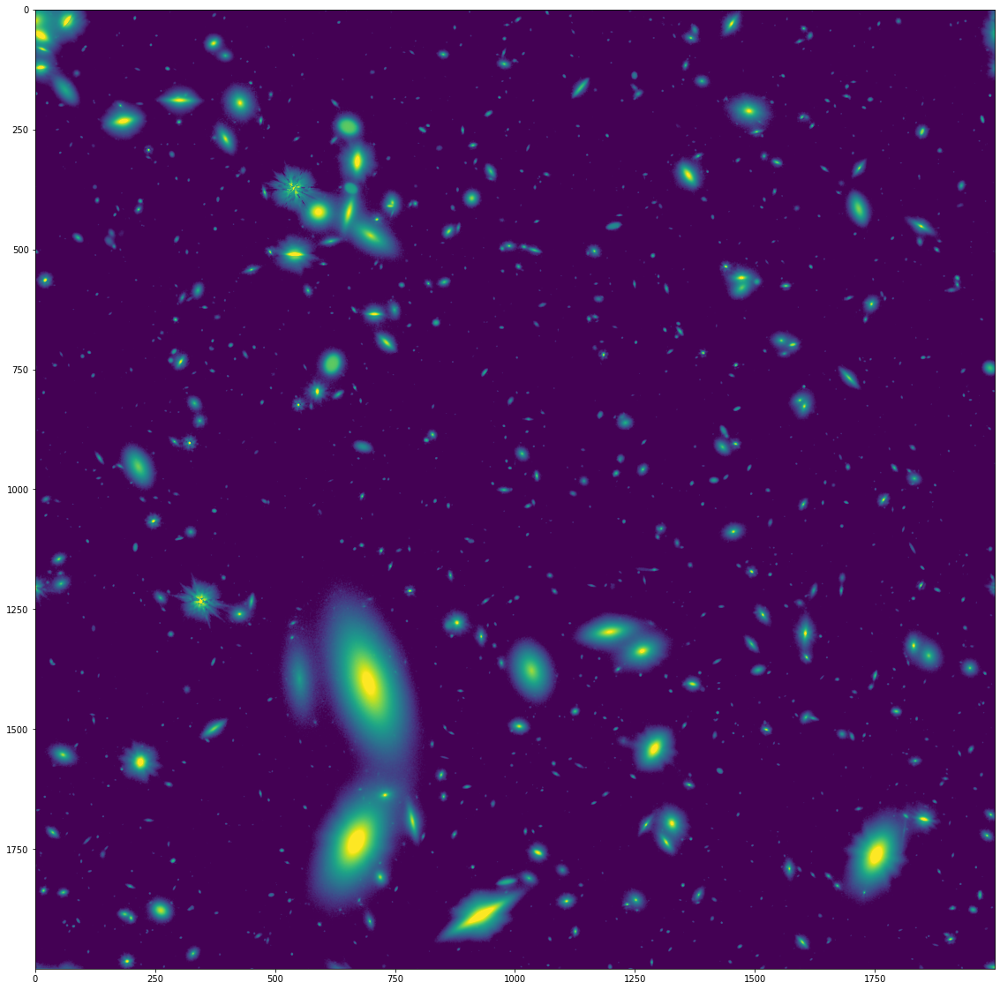

In [348]:
jql.imshow(deconvolved_gauss,fnx=20,fny=20,flag_log=True)
print(deconvolved_gauss.min())
print(deconvolved_gauss.max())
print(deconvolved_gauss.std())

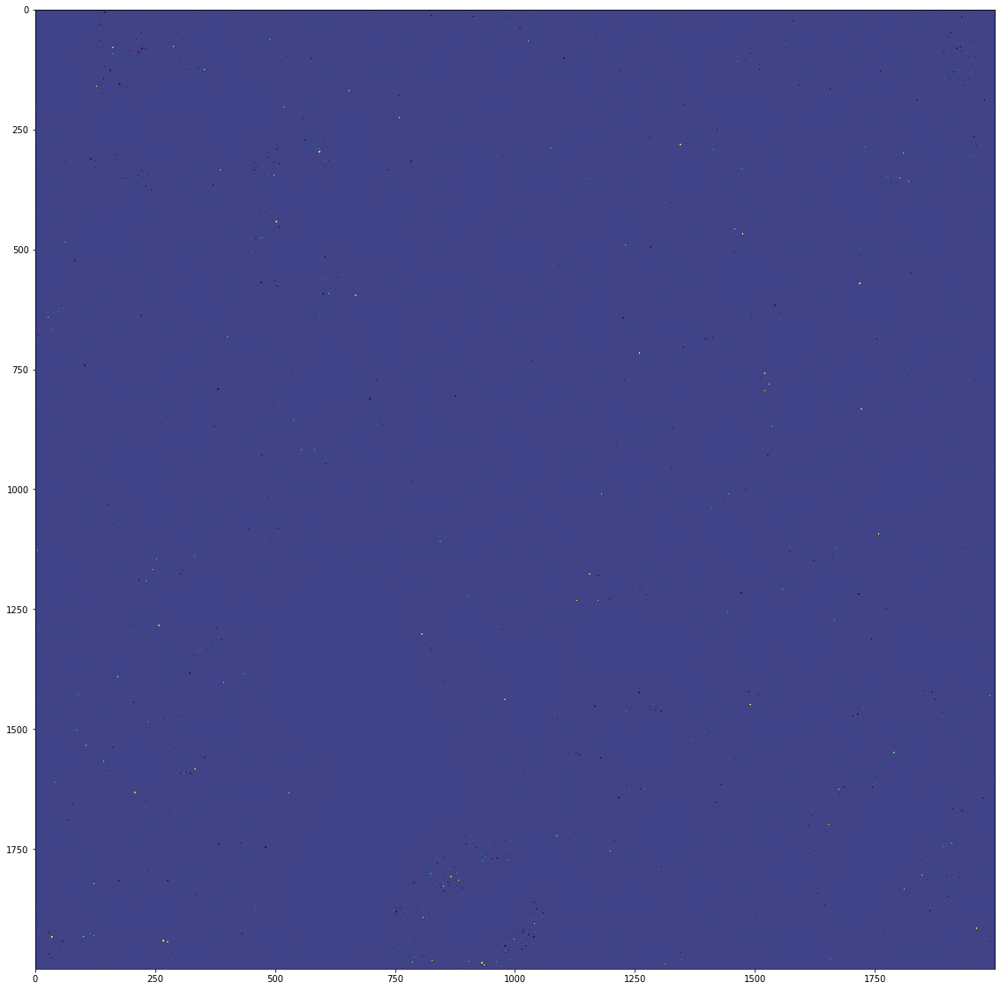

In [307]:
jql.imshow(deconvolved_gauss/deconvolved,fnx=20,fny=20,flag_log=False)


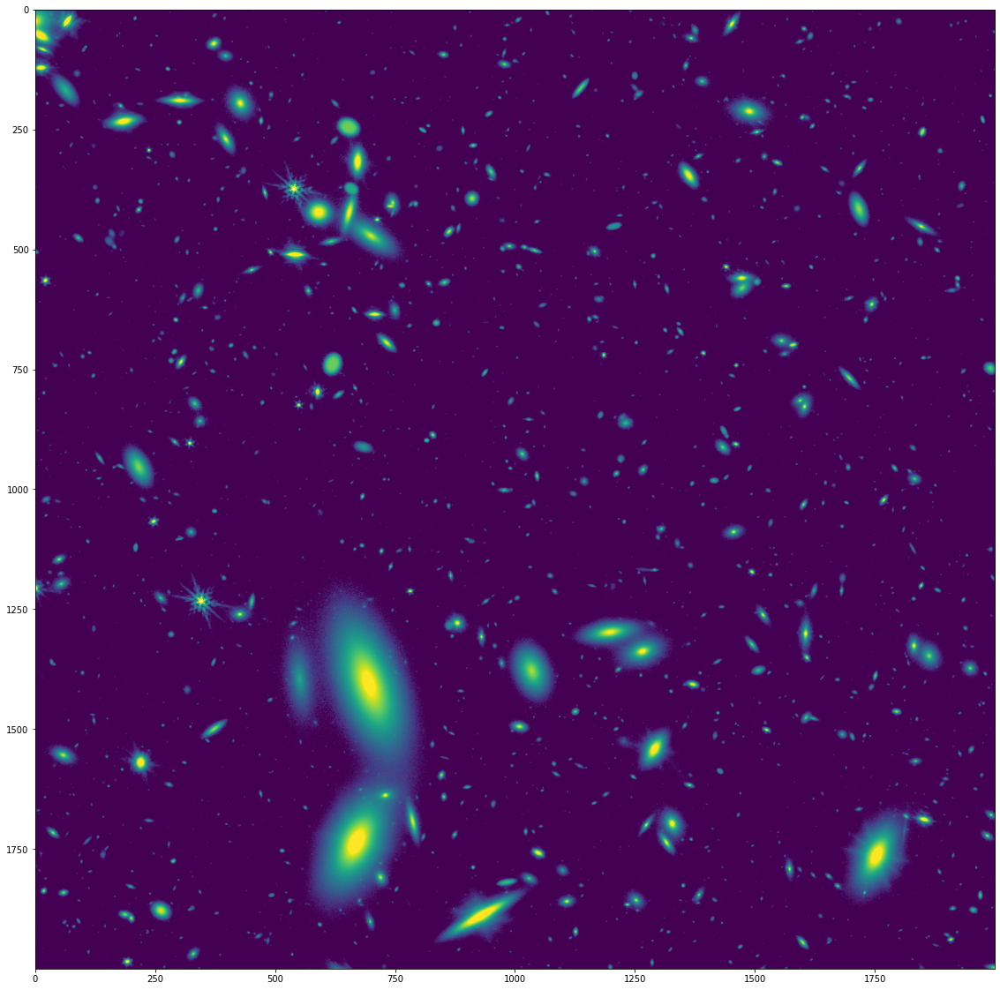

In [290]:
jql.imshow(data_flux.copy(),fnx=20,fny=20,flag_log=True)
#plt.imshow(np.log10(data_flux))

# Possible workflow for de/re-convolution to a common PSF

1) The noise properties of ech flux image are needed. Perform object detection to determine the noise RMS.
2) Use WebbPSF to create the NIRCam PSF of each flux image, keeping a large field of view (~50 arcsec).
3) Rotate the NIRCam PSF to match the position angle.
4) Compute the model PSF for the band used to define the output resolution.
5) Use the input flux image, the rotated NIRCam PSF, the output PSF, and the image noise RMS to perform Wiener deconvolution + reconvolution.
6) Repeat for variance images?

## 1) Compute the noise RMS by using object detection + masking

In [361]:
import sys
import os
sys.path.insert(0,'/home/brant/github/jades-sources/notebooks/')
from jades_lib import paths as jades_paths
import numpy as np
import matplotlib.pyplot as plt
from jades_utils import quicklook as jql
from astropy.io import fits
import jades_psfs as jpsfs

In [362]:
#get the path to the images
jlp = jades_paths()

In [363]:
print(jlp.data_root)

/data/groups/comp-astro/jades/jades-data/


In [364]:
os.listdir(path=jlp.data_root)

['GOODS-N',
 '.dvc',
 'UDS',
 'EGS',
 'fake.dat',
 '.gitignore',
 '.git',
 'GOODS-S',
 '.dvcignore',
 'workflows.md',
 'fake.dat.dvc',
 'README.md',
 'Guitarra']

In [365]:
#define the directory to DC2 images we will be using
fdir_dc2 = jlp.data_root + "Guitarra/images/JWST/DC2-mosaics/v6/"

In [366]:
os.listdir(path=fdir_dc2)

['F410M',
 'F115W',
 'F356W',
 'F277W',
 'F150W',
 'F444W',
 'F335M',
 'F090W',
 'F200W',
 'copy_files.sh']

In [500]:
#Let's start with F356W
fdir_F356W = fdir_dc2+"F356W/"

In [501]:
os.listdir(path=fdir_F356W)

['F356W_exp.fits',
 '.gitignore',
 'readme.md',
 'F356W_err_conv.fits',
 'F356W_conv.fits.dvc',
 'F356W.png.dvc',
 'F356W_err_conv.fits.dvc',
 'F356W_err.fits.dvc',
 'F356W_err.fits',
 'F356W_exp.fits.dvc',
 'F356W.fits.dvc',
 'F356W.png',
 'README.md',
 'F356W.fits',
 'F356W_conv.fits']

In [502]:
#Get flux image file names
fname_F356W_flux_fits = fdir_F356W+"F356W.fits"
fname_F356W_ferr_fits = fdir_F356W+"F356W_err.fits"

In [503]:
#read in flux images
hdu_F356W_flux = fits.open(fname_F356W_flux_fits)
hdu_F356W_ferr = fits.open(fname_F356W_ferr_fits)

In [504]:
#get the data from the HDU
data_F356W_flux = hdu_F356W_flux[0].data
data_F356W_ferr = hdu_F356W_ferr[0].data

In [505]:
#make some cutouts

xmin = 6000
xmax = 8000
ymin = 6000
ymax = 8000
data_flux = jql.cutout(data_F356W_flux,xmin,xmax,ymin,ymax)
data_ferr = jql.cutout(data_F356W_ferr,xmin,xmax,ymin,ymax)

In [506]:
#byte swap
data_flux = data_flux.byteswap(inplace=True).newbyteorder()
data_ferr = data_ferr.byteswap(inplace=True).newbyteorder()

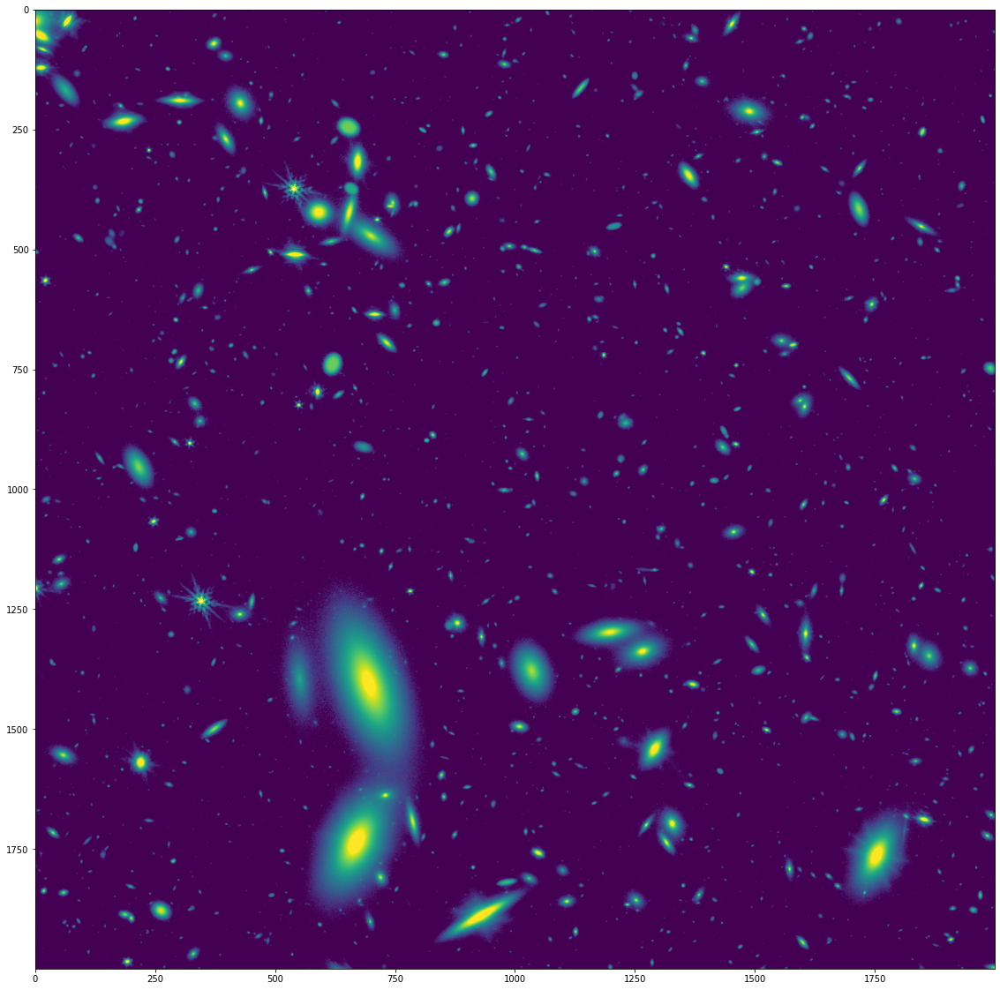

In [507]:
# Show the data
jql.imshow(data_flux,fnx=20,fny=20,flag_log=True)

### Iteratively perform object detection and masking to determine the image RMS

In [508]:
import sep
def iterative_detect_and_mask(data, niter=3):
        
    mask, objects = detect_and_mask(data)
    
    for i in range(niter-1):
        mask, new_objects = detect_and_mask(data,mask=mask)
        objects = np.append(objects,new_objects)
    return mask, objects

In [509]:
def detect_and_mask(data, mask=None):
    
    if(mask is None):
        mask = np.zeros_like(data,dtype=bool)
    
    #measure a background
    bkg = sep.Background(data, mask=mask)
    
    #subtract the background
    data_sub = data - bkg

    #perform object detection
    objects = sep.extract(data_sub, 1.5, err=bkg.globalrms, mask=mask)

    #create a boolean elliptical mask
    sep.mask_ellipse(mask,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=3.)
    
    #return the mask
    return mask, objects

### Perform the iterative masking of sources

In [510]:
mask, objects = iterative_detect_and_mask(data_flux)

### Compute the mean background using the masked image

In [511]:
data_flux_masked = data_flux.copy()
data_flux_masked[mask==True] = np.nan

In [512]:
data_flux_bkg = np.nanmean(data_flux_masked)

print(f"Background level = {data_flux_bkg}")

Background level = 0.03199542686343193


### Subtract a constant background

In [513]:
data_flux_sub = data_flux - data_flux_bkg

In [514]:
data_flux_sub_F356W = data_flux_sub.copy()

### Verify zero mean background

In [382]:
data_flux_sub_masked = data_flux_sub.copy()
data_flux_sub_masked[mask==True] = np.nan
data_flux_sub_bkg = np.nanmean(data_flux_sub_masked)
print(f"Background level after constant background subtraction = {data_flux_sub_bkg}")

Background level after constant background subtraction = -3.800245007568037e-09


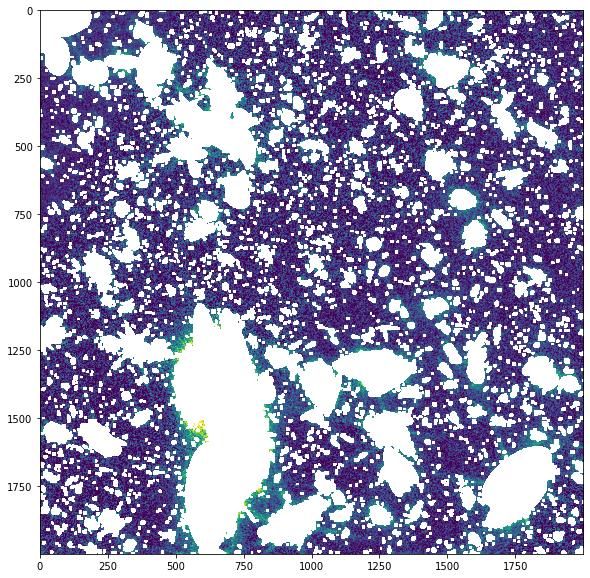

In [389]:
jql.imshow(data_flux_sub_masked,flag_log=False)

### Show a histogram of the zero-mean background

33.67412134408951 0.123126484
Variance of background noise in data image = 0.015160130336880684


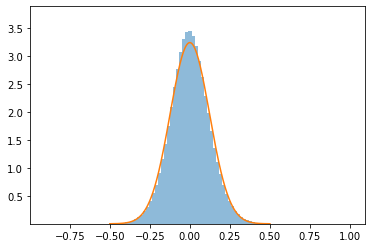

In [397]:
#jql.hist(data_flux_sub_masked,hmin=-0.5,hmax=0.5,density=True,log=False)
#jql.stats(data_flux_sub_masked)
idx = np.where(np.isnan(data_flux_sub_masked)==False)
plt.hist(data_flux_sub_masked[idx].flatten(),bins=100,density=True,alpha=0.5)
#jql.hist(data_flux_sub_masked[idx].flatten(),hmin=-0.5,hmax=0.5,density=True,log=False)
x = np.linspace(-0.5,0.5,1000)
s = np.nanstd(data_flux_sub_masked)
print(31.4 - 2.5*np.log10(s),s)
plt.plot(x,(1./(2*np.pi*s**2)**0.5)*np.exp(-0.5*(x/s)**2))
plt.ylim([1.0e-6,1.2/(2*np.pi*s**2)**0.5])



variance_data_flux_sub = np.nanvar(data_flux_sub_masked)
print(f"Variance of background noise in data image = {variance_data_flux_sub}")

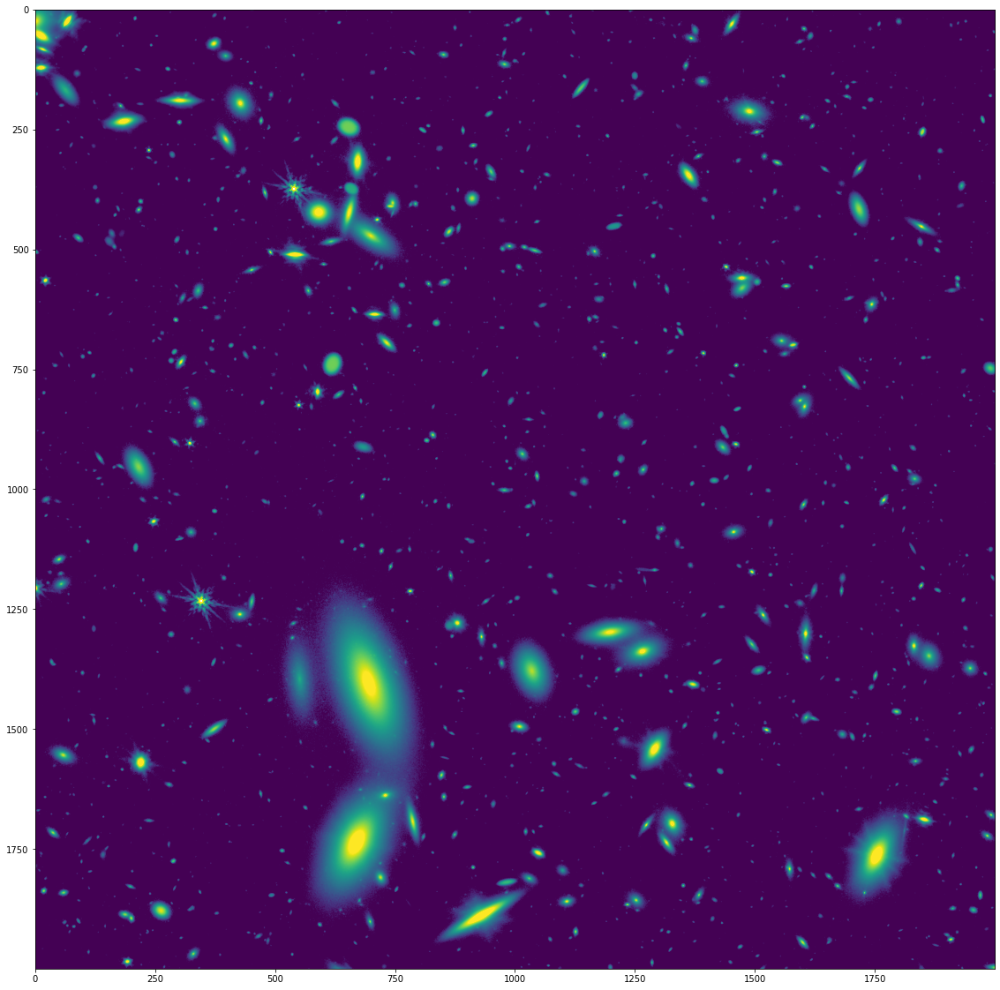

In [396]:
jql.imshow(data_flux_sub,fnx=20,fny=20,flag_log=True)

## 2) Use WebbPSF to create the NIRCam PSF of each flux image, keeping a large field of view (~50 arcsec).

In [398]:
import os
!export WEBBPSF_PATH=/data/groups/comp-astro/jades/webbpsf-data 
os.environ["WEBBPSF_PATH"] = "/data/groups/comp-astro/jades/webbpsf-data"
import webbpsf

### Create the PSF

In [399]:
nc.filter = 'F356W'
hdu_F356W = nc.calc_psf(detector_oversample=1,fft_oversample=4,fov_arcsec=50.0)
psf_F356W = hdu_F356W[0].data
print(psf_F356W.shape)

(794, 794)


### Plot the PSF

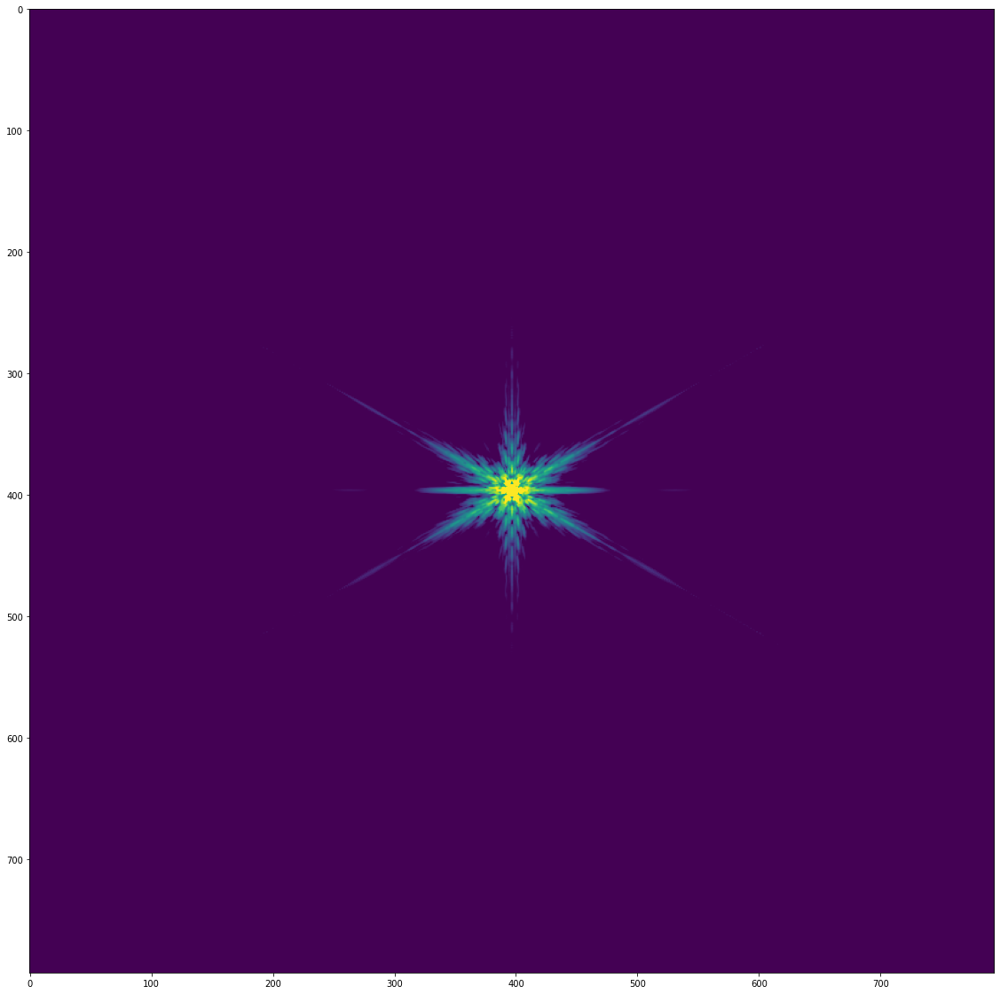

In [402]:
jql.imshow(psf_F356W,fnx=20,fny=20,flag_log=True)

In [401]:
PA = -26.0  # note sign convention

## 3) Rotate the NIRCam PSF to match the position angle.

### Define the position angle

In [403]:
PA = -26.0 #note the sign convention

### Rotate the PSF

In [405]:
from scipy.ndimage.interpolation import rotate
psf_F356W_rotated = rotate(psf_F356W,angle=PA)

### Plot the rotated PSF

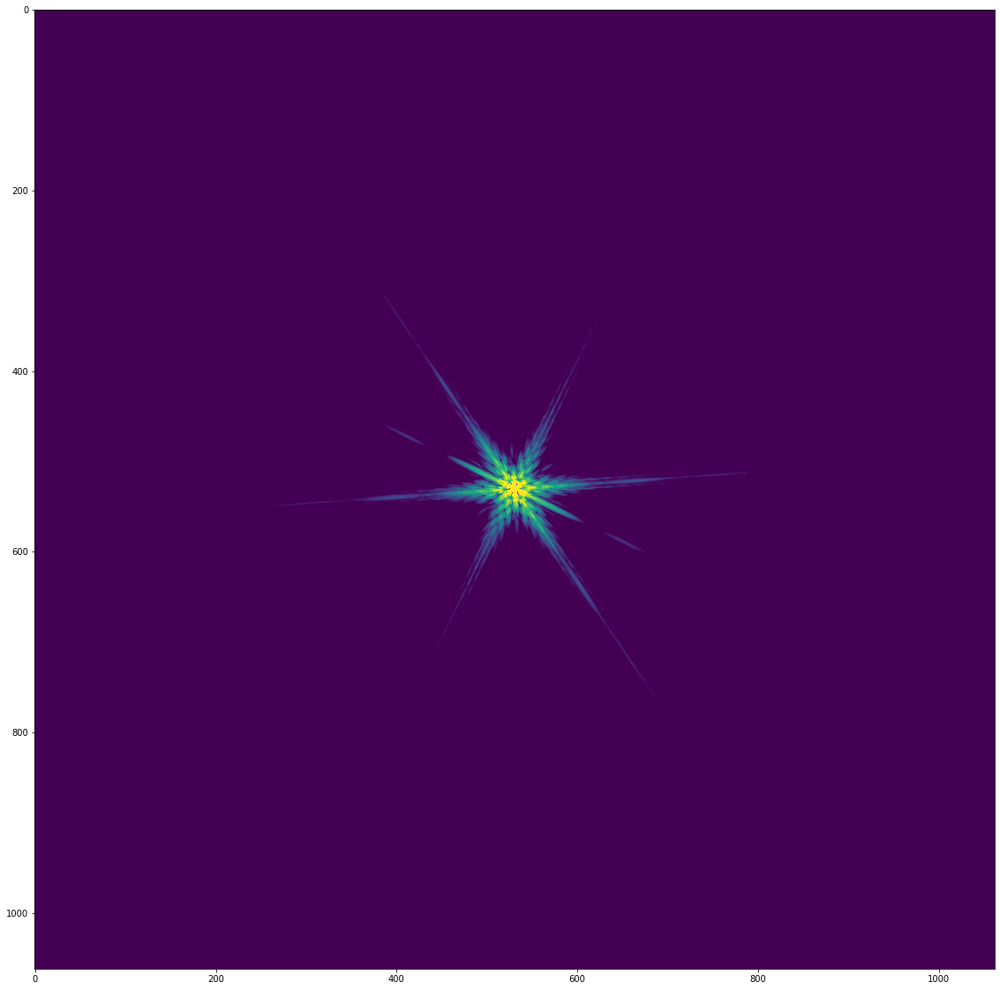

In [406]:
jql.imshow(psf_F356W_rotated,fnx=20,fny=20,flag_log=True)

In [438]:
#copy the rotated psf
psf_rot = psf_F356W_rotated.copy()

## 4) Compute the model PSF for the band used to define the output resolution.

A choice has to be made here.  We are defining the final PSF with 

In [407]:
import tensorflow as tf
import tensorflow_probability as tfp
tfd = tfp.distributions

In [416]:
### copy the psf for convenience
### here we will use F356W
psf =  psf_F356W.copy()

### Compute FFT of PSF

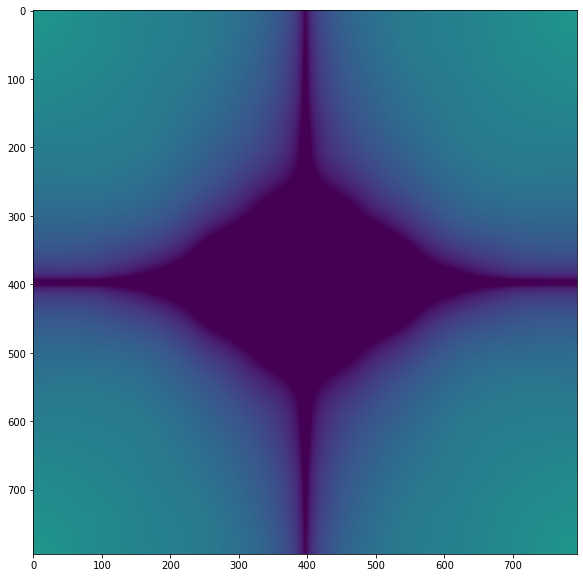

In [422]:
psf_fft = np.absolute(np.fft.fft2(psf))
jql.imshow(np.log10(psf_fft),flag_log=False)

### Define a function to create the grid locations for the PSF model

In [414]:
def gridxy(nx=161,ny=161):
    xl = np.arange(nx,dtype=np.float32)
    yl = np.arange(ny,dtype=np.float32)
    x,y = np.meshgrid(xl,yl)
    xy = np.dstack((x,y))
    return xy

### Model the PSF using multiple Gaussians in configuration space and a Tukey filter in Fourier space

We will use tensorflow to perform the optimization

In [423]:
#get the dimensions of the PSF
nx = psf.shape[0]
ny = psf.shape[1]
print(f"PSF shape {nx}, {ny}.")


#initialize xy grid
xy = gridxy(nx=nx,ny=ny)


#Initialize the parameters:
# Amplitudes of the gaussians a_0, a_1, a_2
# x and y stddevs of the gaussians sig_0_x, sig_0_y
#  sig_1_x, sig_1_y, and  sig_2_x, sig_2_y
# The width of the transition 1-> in the tukey filter t_a
# The ratio of semimajor to semiminor axes of the filter
# the ics were estimated from F444W
a_0 = tf.Variable(1.3587886095046997, name='a_0')
a_1 = tf.Variable(0.7991504073143005, name='a_1')
a_2 = tf.Variable(0.11792205274105072, name='a_2')
sig_0_x  = tf.Variable(1.1070048809051514,  name='sig_0_x')                        
sig_0_y  = tf.Variable(1.0063364505767822,  name='sig_0_y')
sig_1_x  = tf.Variable(7.243698596954346,   name='sig_1_x')                       
sig_1_y  = tf.Variable(6.162914752960205,   name='sig_1_y')
sig_2_x  = tf.Variable(20.59847640991211,   name='sig_2_x')                      
sig_2_y  = tf.Variable(19.640581130981445,   name='sig_2_y')
t_a      = tf.Variable(0.09996941685676575, name='t_a')
t_b      = tf.Variable(0.9590688347816467, name='t_b')


#scale between configuration and log fourier losses
scale = 1.0e-6

#define the center by hand
#could fit as a parameter
mu_x_const = 0.5*(nx-1)
mu_y_const = 0.5*(ny-1)


#define the 3-gaussian model
@tf.function
def mvn_three_fit(x):
    mu = [mu_x_const,mu_y_const]
    sigma_0 = [sig_0_x,sig_0_y]
    sigma_1 = [sig_1_x,sig_1_y]
    sigma_2 = [sig_2_x,sig_2_y]
    gmvn_0 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_0)
    gmvn_1 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_1)
    gmvn_2 = tfd.MultivariateNormalDiag(loc=mu,scale_diag=sigma_2)
    return tf.math.abs(a_0)*gmvn_0.prob(x)+tf.math.abs(a_1)*gmvn_1.prob(x)+tf.math.abs(a_2)*gmvn_2.prob(x)



#define the tukey transition function
def tukey_trans(fx,a,lam):
    return 0.5*(1-tf.math.cos((np.pi*fx/(a*lam) - np.pi/a) ))
    

#calculate the shape of the tukey filter
def tukey_calc(x,ta):
    # Def 4.3 of 1901.04365    
    lam = mu_x_const-1.
    al = (1.0-t_a)*lam
    fx = tf.abs(x)
    y = tf.zeros(x.shape)
    
    #inner bump
    #xs = x[fx<al]
    one_index = tf.math.less(fx,al)
    y = tf.where(one_index,tf.ones(x.shape),tf.zeros(x.shape))

    #transition
    and_index = tf.math.less_equal(fx,lam)&tf.math.greater_equal(fx,al)
    y_trans = tf.where(and_index,tukey_trans(fx,ta,lam),y)

    #result
    return y_trans


#tukey filter
@tf.function
def tukey(x):
    nx = x.shape[0]
    ny = x.shape[1]
    ta = t_a
    xx = x#.numpy()
    #return tukey_calc((xx[:,:,0]**2 + xx[:,:,1]**2)**0.5,ta) + tukey_calc(((xx[:,:,0]-nx)**2 + xx[:,:,1]**2)**0.5,ta) + tukey_calc((xx[:,:,0]**2 + (xx[:,:,1]-ny)**2)**0.5,ta) + tukey_calc(((xx[:,:,0]-nx)**2 + (xx[:,:,1]-ny)**2)**0.5,ta)
    x0 = tf.math.sqrt(tf.math.pow(x[:,:,0],2) + tf.math.pow(x[:,:,1]/t_b,2) ) 
    x1 = tf.math.sqrt(tf.math.pow(nx-1-x[:,:,0],2) + tf.math.pow(x[:,:,1]/t_b,2) ) 
    x2 = tf.math.sqrt(tf.math.pow(x[:,:,0]   ,2) + tf.math.pow((ny-1-x[:,:,1])/t_b,2) ) 
    x3 = tf.math.sqrt(tf.math.pow(nx-1-x[:,:,0],2) + tf.math.pow((ny-1-x[:,:,1])/t_b,2) ) 

    t_real = tukey_calc(x0,ta) + tukey_calc(x1,ta) + tukey_calc(x2,ta) + tukey_calc(x3,ta)
    
    return t_real/tf.math.reduce_max(t_real)


#define the loss function
loss_fn = tf.keras.losses.MeanSquaredError(reduction=tf.keras.losses.Reduction.SUM)

#define mse
@tf.function
def mse(y_true_in, y_pred_in):
    return loss_fn(y_true=y_true_in,y_pred=y_pred_in)

#Define the Adam Optimizer and learning rate
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)


#flag_train = False
flag_train = True
if(flag_train):
    #start training
    epochs = 10000
    display_step = 1000
    for epoch in range(epochs):
    
        #monitor training / display steps
        if((epoch%display_step)==0):
            pred = mvn_three_fit(xy)
            tukey_filter = tukey(xy)
            pred_fft = tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred)))
            pred_fft_tuk = tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)
            pred = tf.math.abs(tf.signal.ifft2d(tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)))
            pred *= tf.math.reduce_sum(tf.cast(psf[60:100,60:100],tf.float32))/tf.math.reduce_sum(pred[60:100,60:100])
            pred_fft = tf.math.abs(tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred))))
            loss = mse(pred, psf) + scale*mse(tf.math.log(pred_fft), tf.math.log(psf_fft))
            loss += mse(tf.math.log(pred_fft[:,0]),tf.math.log(psf_fft[:,0])) + mse(tf.math.log(pred_fft[0,:]),tf.math.log(psf_fft[0,:])) 
            limin = int(0.5*(nx-1)) - 20
            limax = int(0.5*(nx-1)) + 20
            loss += mse(tf.math.log(pred[limin:limax,int(0.5*(nx-1))]), tf.math.log(psf[limin:limax,int(0.5*(nx-1))]))
            loss += mse(tf.math.log(pred[int(0.5*(nx-1)),limin:limax]), tf.math.log(psf[int(0.5*(nx-1)),limin:limax]))
            print(f"Epoch {epoch} | Loss {loss.numpy()} a_0:{a_0.numpy()} a_1:{a_1.numpy()} a_2:{a_2.numpy()}")
            print(f"Epoch {epoch} | Loss {loss.numpy()} s_x_a:{sig_0_x.numpy()} s_y_a:{sig_0_y.numpy()} s_x_b:{sig_1_x.numpy()} s_y_b:{sig_1_y.numpy()}  s_2_x:{sig_2_x.numpy()} s_2_y:{sig_2_y.numpy()}")
            print(f"Epoch {epoch} | Loss {loss.numpy()} t_a:{t_a.numpy()} t_b:{t_b.numpy()}")
            print(f"Epoch {epoch} | Loss {loss.numpy()} sum model:{(tf.math.reduce_sum(pred)).numpy()} sum:{(tf.math.reduce_sum(psf)).numpy()}")


        #begin GradientTape and optimize
        with tf.GradientTape() as g:
            pred = mvn_three_fit(xy)
            tukey_filter = tukey(xy)
            pred_fft = tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred)))
            pred_fft_tuk = tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)
            pred = tf.math.abs(tf.signal.ifft2d(tf.complex(tf.math.real(pred_fft)*tukey_filter,tf.math.imag(pred_fft)*tukey_filter)))
            pred *= tf.math.reduce_sum(tf.cast(psf[60:100,60:100],tf.float32))/tf.math.reduce_sum(pred[60:100,60:100])
            pred_fft = tf.math.abs(tf.signal.fft2d(tf.dtypes.complex(pred,tf.zeros_like(pred))))
            loss = mse(pred, psf) + scale*mse(tf.math.log(pred_fft), tf.math.log(psf_fft)) 
            loss += mse(tf.math.log(pred_fft[:,0]),tf.math.log(psf_fft[:,0])) + mse(tf.math.log(pred_fft[0,:]),tf.math.log(psf_fft[0,:])) 
            limin = int(0.5*(nx-1)) - 20
            limax = int(0.5*(nx-1)) + 20
            loss += mse(tf.math.log(pred[limin:limax,int(0.5*(nx-1))]), tf.math.log(psf[limin:limax,int(0.5*(nx-1))]))
            loss += mse(tf.math.log(pred[int(0.5*(nx-1)),limin:limax]), tf.math.log(psf[int(0.5*(nx-1)),limin:limax]))


        #compute gradients
        gradients = g.gradient(loss, [a_0,a_1,a_2,sig_0_x,sig_0_y,sig_1_x,sig_1_y,sig_2_x,sig_2_y,t_a,t_b])

        #update parameters
        optimizer.apply_gradients(zip(gradients,[a_0,a_1,a_2,sig_0_x,sig_0_y,sig_1_x,sig_1_y,sig_2_x,sig_2_y,t_a,t_b]))
    
    loss = mse(pred, psf) + scale*mse(tf.math.log(pred_fft), tf.math.log(psf_fft))
    loss += mse(tf.math.log(pred_fft[:,0]),tf.math.log(psf_fft[:,0])) + mse(tf.math.log(pred_fft[0,:]),tf.math.log(psf_fft[0,:])) 
    limin = int(0.5*(nx-1)) - 20
    limax = int(0.5*(nx-1)) + 20
    loss += mse(tf.math.log(pred[limin:limax,int(0.5*(nx-1))]), tf.math.log(psf[limin:limax,int(0.5*(nx-1))]))
    loss += mse(tf.math.log(pred[int(0.5*(nx-1)),limin:limax]), tf.math.log(psf[int(0.5*(nx-1)),limin:limax]))
    epoch = epochs
    print(f"Epoch {epoch} | Loss {loss.numpy()} a_0:{a_0.numpy()} a_1:{a_1.numpy()} a_2:{a_2.numpy()}")
    print(f"Epoch {epoch} | Loss {loss.numpy()} s_x_a:{sig_0_x.numpy()} s_y_a:{sig_0_y.numpy()} s_x_b:{sig_1_x.numpy()} s_y_b:{sig_1_y.numpy()}  s_2_x:{sig_2_x.numpy()} s_2_y:{sig_2_y.numpy()}")
    print(f"Epoch {epoch} | Loss {loss.numpy()} t_a:{t_a.numpy()} t_b:{t_b.numpy()}")
    print(f"Epoch {epoch} | Loss {loss.numpy()} sum model:{(tf.math.reduce_sum(pred)).numpy()} sum:{(tf.math.reduce_sum(psf)).numpy()}")


PSF shape 794, 794.
Epoch 0 | Loss 18.348669400832094 a_0:1.3587886095046997 a_1:0.7991504073143005 a_2:0.11792205274105072
Epoch 0 | Loss 18.348669400832094 s_x_a:1.1070048809051514 s_y_a:1.0063364505767822 s_x_b:7.243698596954346 s_y_b:6.162914752960205  s_2_x:20.59847640991211 s_2_y:19.640581130981445
Epoch 0 | Loss 18.348669400832094 t_a:0.09996941685676575 t_b:0.9590688347816467
Epoch 0 | Loss 18.348669400832094 sum model:3.5560801029205322 sum:0.9976983091321535
Epoch 1000 | Loss 12.189696536432605 a_0:1.4356372356414795 a_1:0.7097184658050537 a_2:0.10512569546699524
Epoch 1000 | Loss 12.189696536432605 s_x_a:1.0159887075424194 s_y_a:0.9426096081733704 s_x_b:7.14415979385376 s_y_b:6.20650577545166  s_2_x:20.580921173095703 s_2_y:19.5748233795166
Epoch 1000 | Loss 12.189696536432605 t_a:0.09913518279790878 t_b:0.9592456221580505
Epoch 1000 | Loss 12.189696536432605 sum model:1.8357301950454712 sum:0.9976983091321535
Epoch 2000 | Loss 10.149596191244074 a_0:1.5002014636993408 a_1:0

In [425]:
#copy the model PSF
psf_pred = pred.numpy().copy()

In [426]:
#get the FFT of the model PSF
psf_pred_fft = np.fft.fft2(psf_pred)

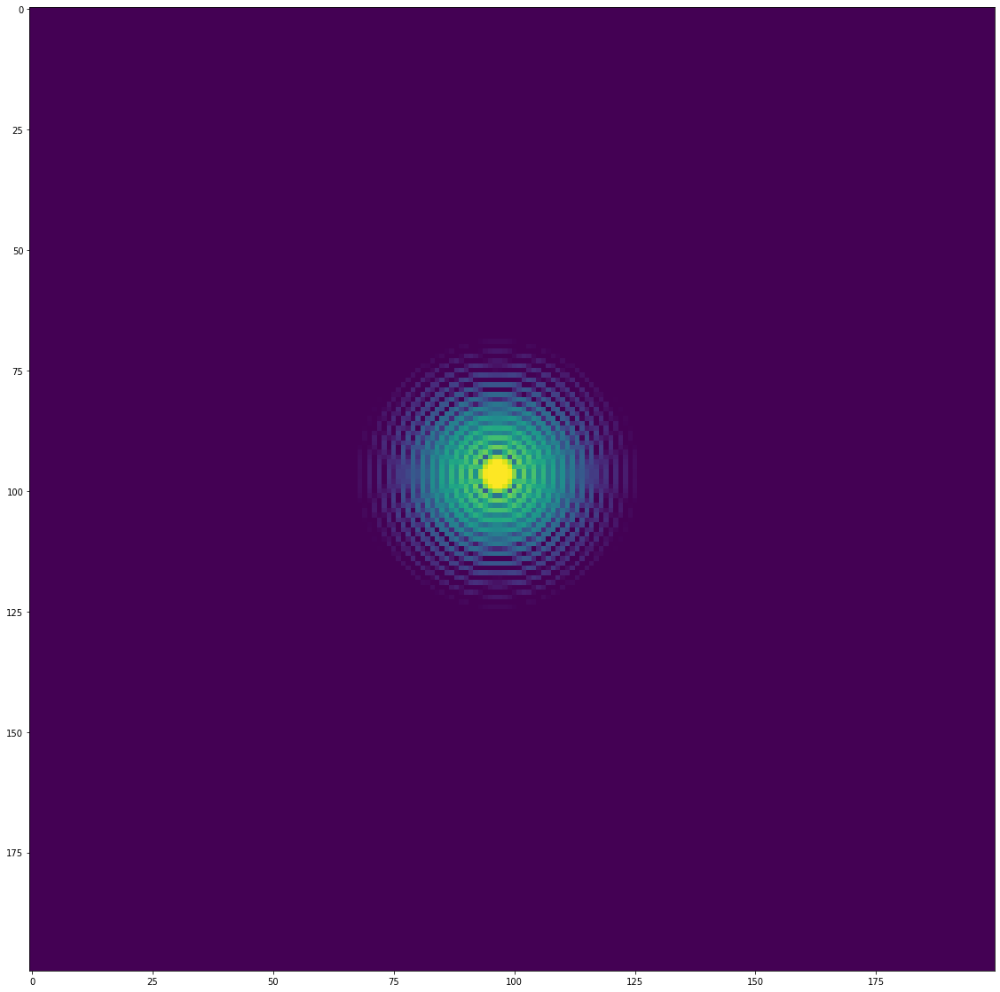

In [459]:
#plot the model PSF
jql.imshow(psf_pred[300:500,300:500],fnx=20,fny=20,flag_log=True)

In [429]:
# get the gaussian model w/o the tukey filter
psf_pred_gaussian = mvn_three_fit(xy).numpy()

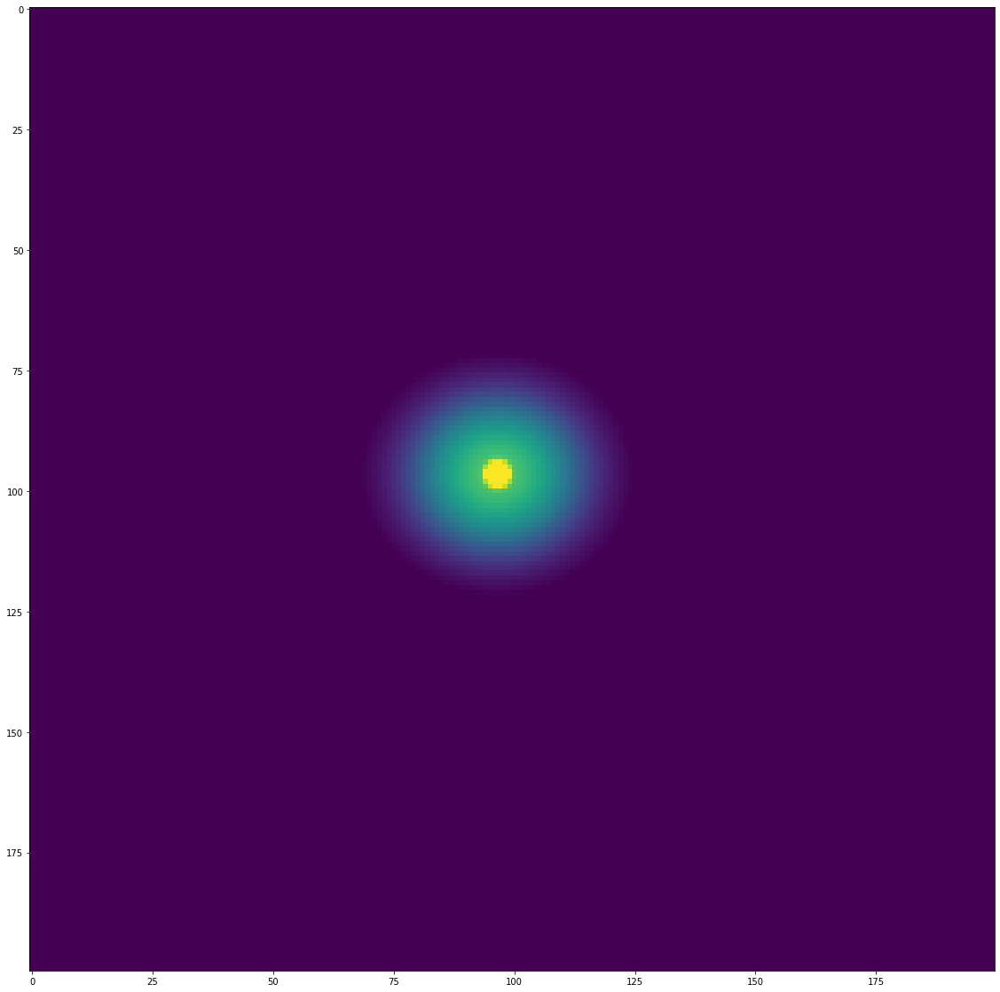

In [460]:
#plot the gaussian model
jql.imshow(psf_pred_gaussian[300:500,300:500],fnx=20,fny=20,flag_log=True)

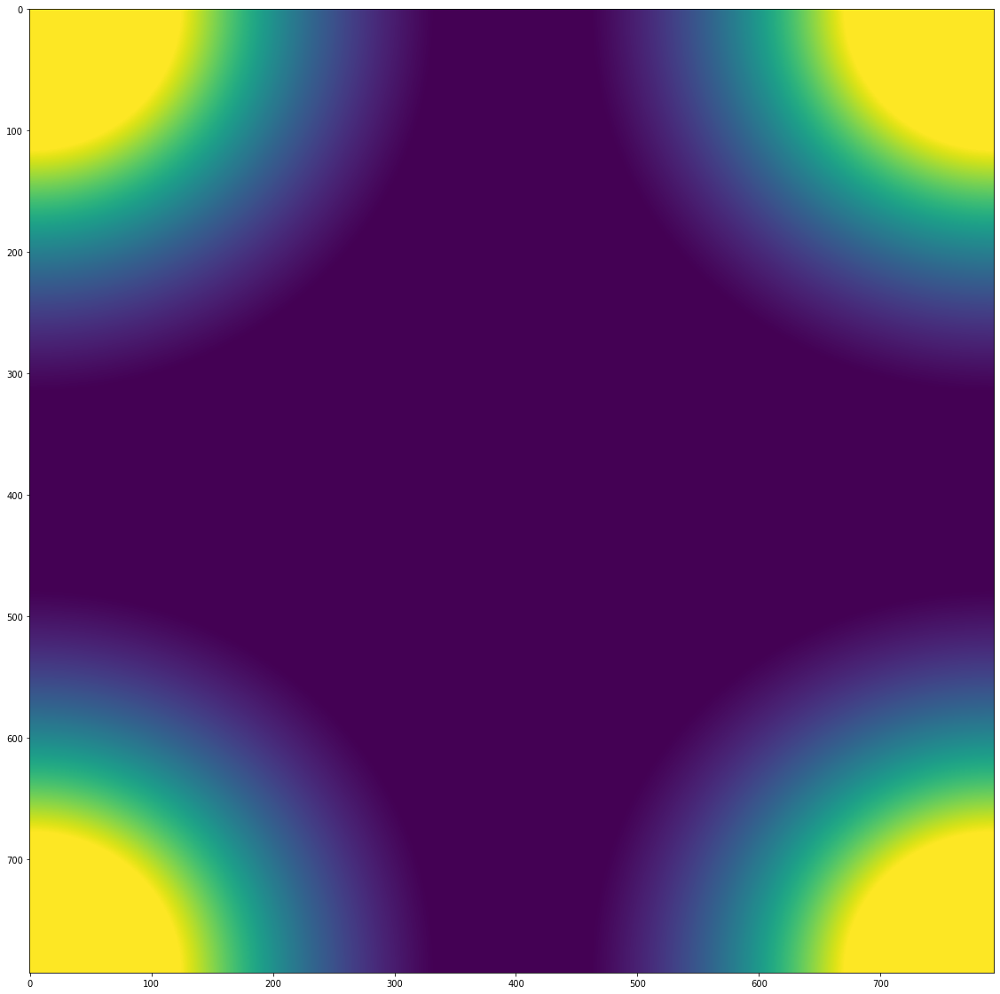

In [472]:
jql.imshow(np.absolute(psf_pred_fft),fnx=20,fny=20)

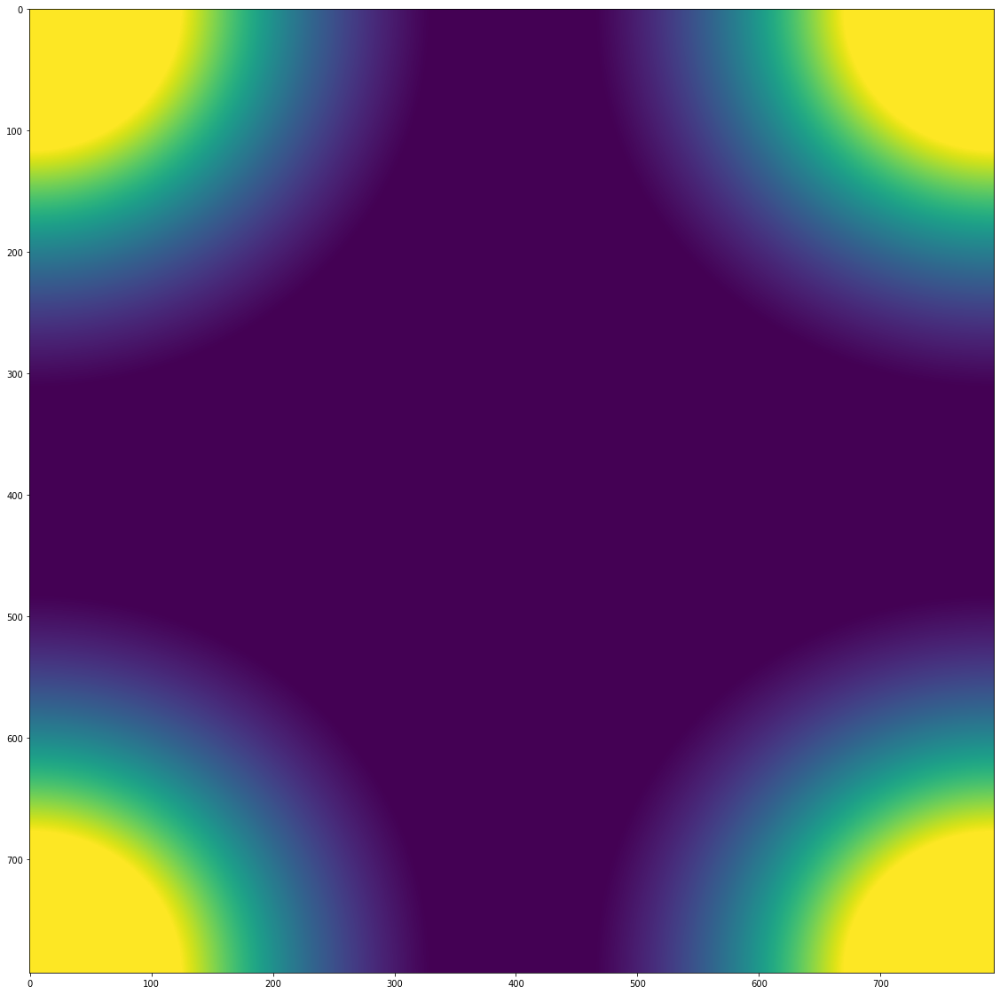

In [473]:
jql.imshow(np.absolute(np.fft.fft2(psf_pred_gaussian)),fnx=20,fny=20)

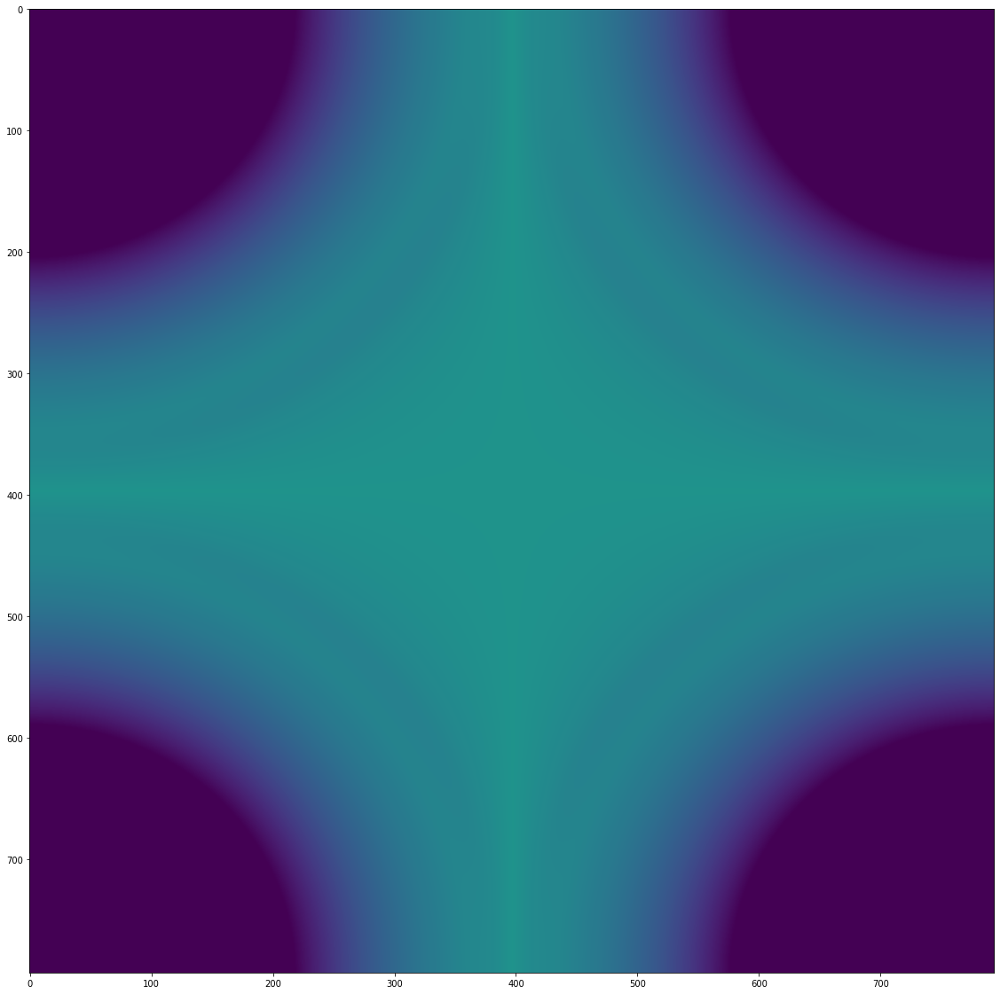

In [475]:
jql.imshow(np.absolute(psf_pred_fft)-np.absolute(np.fft.fft2(psf_pred_gaussian)),fnx=20,fny=20)

## 5) Use the input flux image, the rotated NIRCam PSF, the output PSF, and the image noise RMS to perform Wiener deconvolution + reconvolution.

In [515]:
signal = data_flux_sub_F356W.copy()
kernel = np.zeros_like(signal)
pkernel = np.zeros_like(signal)


#NIRCam PSF kernel
nkx = psf_rot.shape[0]
nky = psf_rot.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
kernel[iko:iko+nkx,jko:jko+nky] += psf_rot.copy()

#Model output PSF
pred_kernel = psf_pred.copy()
pred_kernel/=np.sum(pred_kernel)
nkx = pred_kernel.shape[0]
nky = pred_kernel.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
pkernel[iko:iko+nkx,jko:jko+nky] += pred_kernel


#Avoid any nasty nans
idx = np.where(np.isnan(signal))
signal[idx] = 0


#perform Wiener deconvolution w/ convolution to final PSF
H = np.fft.fft2(kernel)
data_model_F356W = np.real(np.fft.ifft2(np.fft.fft2(pkernel)*np.fft.fft2(signal)*np.conj(H)/(np.absolute(H)**2 + variance_data_flux_sub)))

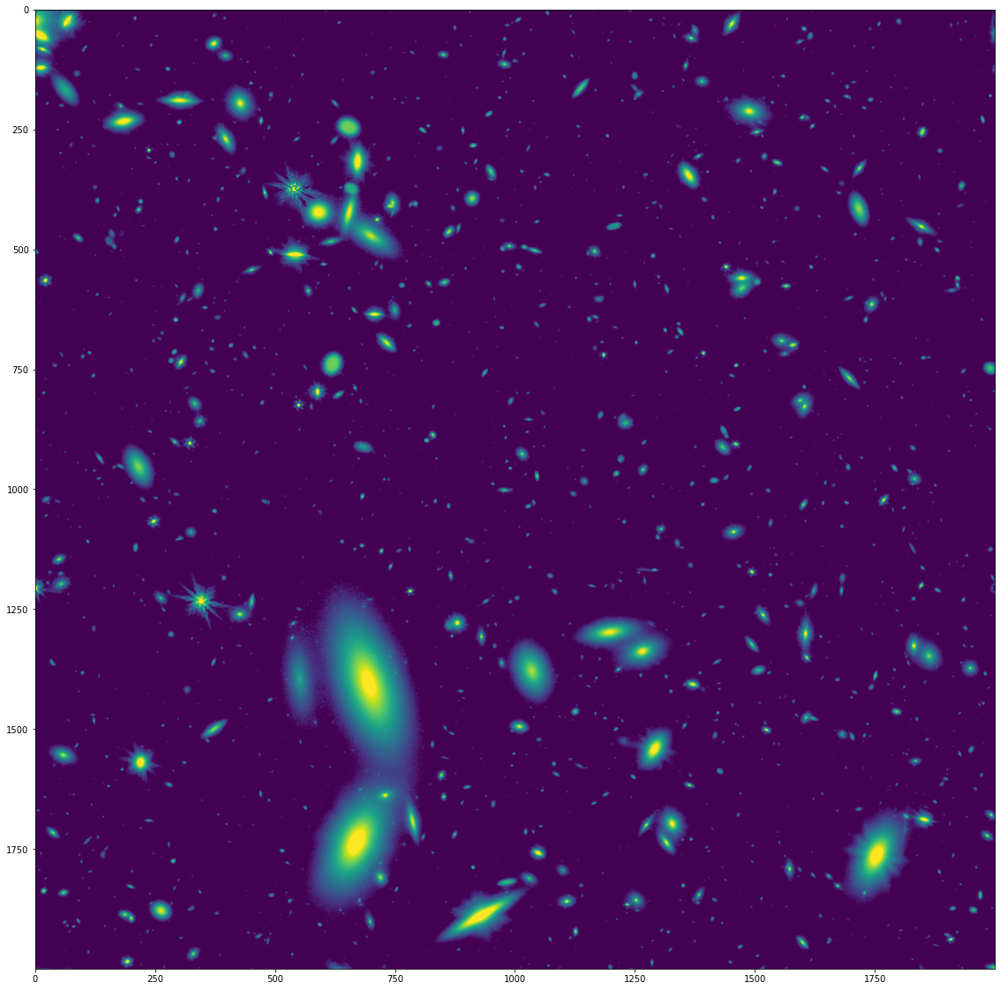

In [516]:
# Plot convolved image
#jql.imshow(data_model,fnx=20,fny=20,flag_log=True)
#jql.imshow(data_model,fnx=20,fny=20,flag_log=True)
jql.imshow(data_model_F356W,fnx=20,fny=20,flag_log=True)

In [463]:
#repeate with gaussian
signal = data_flux_sub.copy()
kernel = np.zeros_like(signal)
pkernel = np.zeros_like(signal)


#NIRCam PSF kernel
nkx = psf_rot.shape[0]
nky = psf_rot.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
kernel[iko:iko+nkx,jko:jko+nky] += psf_rot.copy()

#Model output PSF
pred_kernel = psf_pred_gaussian.copy()  #use gaussian instead
pred_kernel/=np.sum(pred_kernel)
nkx = pred_kernel.shape[0]
nky = pred_kernel.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
pkernel[iko:iko+nkx,jko:jko+nky] += pred_kernel.copy()


#Avoid any nasty nans
idx = np.where(np.isnan(signal))
signal[idx] = 0


#perform Wiener deconvolution w/ convolution to final PSF
H = np.fft.fft2(kernel)
data_model_gaussian = np.real(np.fft.ifft2(np.fft.fft2(pkernel)*np.fft.fft2(signal)*np.conj(H)/(np.absolute(H)**2 + variance_data_flux_sub)))

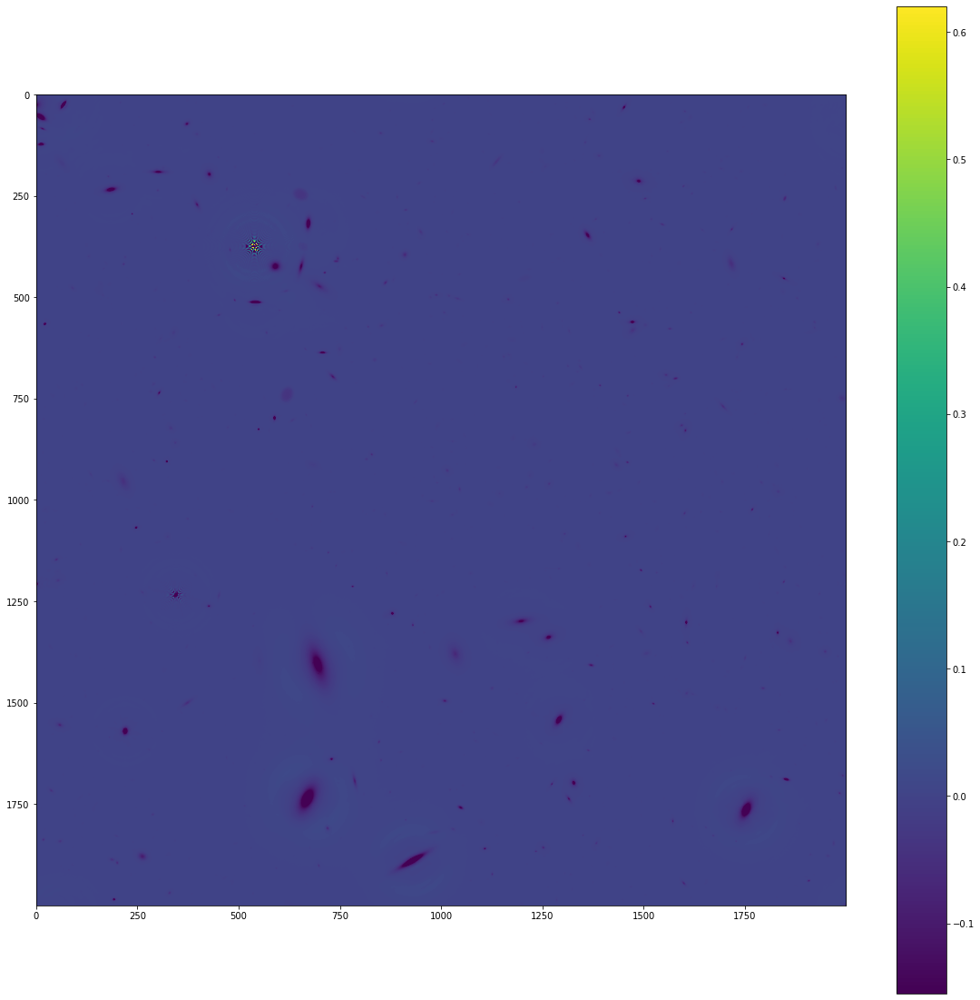

In [471]:
jql.imshow(data_model-data_model_gaussian,fnx=20,fny=20,flag_log=False)
plt.colorbar()

In [466]:
#compare RMS for model PSF and gaussian PSF images

In [469]:
data_model_masked = data_model.copy()
#data_model_masked[mask==True] = np.nan
print(f"RMS background in model PSF image = {np.nanstd(data_model_masked)}")

data_model_gaussian_masked = data_model_gaussian.copy()
#data_model_gaussian_masked[mask==True] = np.nan
print(f"RMS background in gaussian PSF image = {np.nanstd(data_model_gaussian_masked)}")


RMS background in model PSF image = 22.965908296766155
RMS background in gaussian PSF image = 23.005563500606936


## Repeat for F277W

In [477]:
#Let's start with F277W
fdir_F277W = fdir_dc2+"F277W/"

In [478]:
#Get flux image file names
fname_F277W_flux_fits = fdir_F277W+"F277W.fits"
fname_F277W_ferr_fits = fdir_F277W+"F277W_err.fits"

In [481]:
#read in flux images
hdu_F277W_flux = fits.open(fname_F277W_flux_fits)
hdu_F277W_ferr = fits.open(fname_F277W_ferr_fits)

In [482]:
#get the data from the HDU
data_F277W_flux = hdu_F277W_flux[0].data
data_F277W_ferr = hdu_F277W_ferr[0].data

In [484]:
#make some cutouts

xmin = 6000
xmax = 8000
ymin = 6000
ymax = 8000
data_flux_F277W = jql.cutout(data_F277W_flux,xmin,xmax,ymin,ymax)
data_ferr_F277W = jql.cutout(data_F277W_ferr,xmin,xmax,ymin,ymax)

In [485]:
#byte swap
data_flux_F277W = data_flux_F277W.byteswap(inplace=True).newbyteorder()
data_ferr_F277W = data_ferr_F277W.byteswap(inplace=True).newbyteorder()

### Perform the iterative masking of sources

In [487]:
mask_F277W, objects_F277W = iterative_detect_and_mask(data_flux_F277W)

### Compute the mean background using the masked image

In [488]:
data_flux_masked = data_flux_F277W.copy()
data_flux_masked[mask==True] = np.nan

In [489]:
data_flux_bkg = np.nanmean(data_flux_masked)

print(f"Background level = {data_flux_bkg}")

Background level = 0.19436725974082947


### Subtract a constant background

In [490]:
data_flux_sub = data_flux_F277W.copy() - data_flux_bkg

### Verify zero mean background

In [491]:
data_flux_sub_masked = data_flux_sub.copy()
data_flux_sub_masked[mask==True] = np.nan
data_flux_sub_bkg = np.nanmean(data_flux_sub_masked)
print(f"Background level after constant background subtraction = {data_flux_sub_bkg}")

Background level after constant background subtraction = 9.785021148900341e-08


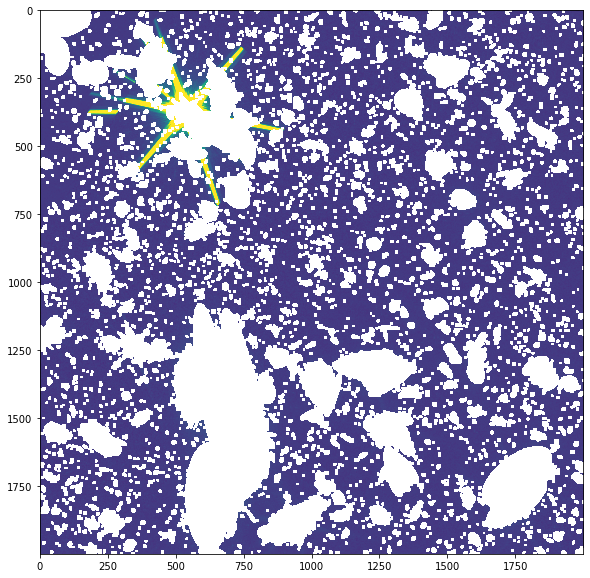

In [492]:
jql.imshow(data_flux_sub_masked,flag_log=False)

In [ ]:
### Compute the RMS of the masked image

### Create the PSF

In [493]:
nc.filter = 'F277W'
hdu_F277W = nc.calc_psf(detector_oversample=1,fft_oversample=4,fov_arcsec=50.0)
psf_F277W = hdu_F277W[0].data
print(psf_F277W.shape)

(794, 794)


### Rotate the PSF

In [494]:
psf_F277W_rotated = rotate(psf_F277W,angle=PA)

### Plot the rotated PSF

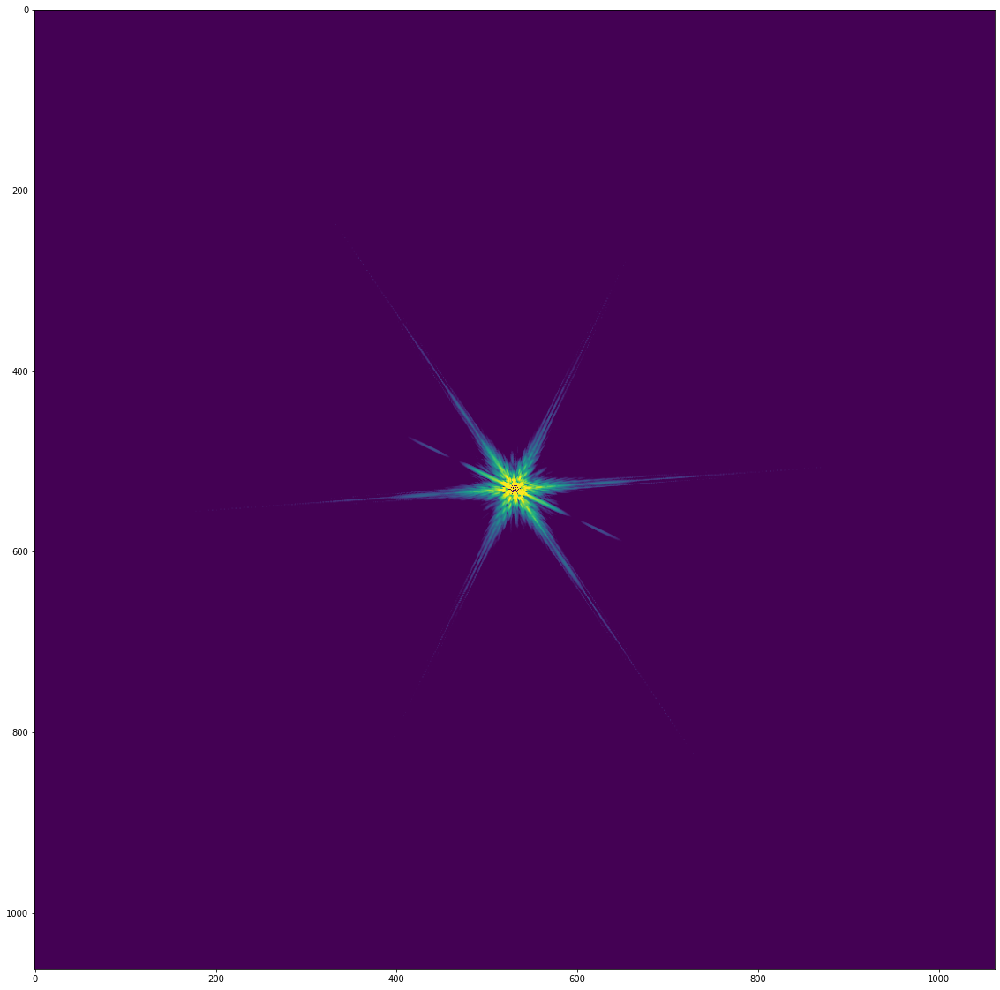

In [495]:
jql.imshow(psf_F277W_rotated,fnx=20,fny=20,flag_log=True)

In [496]:
psf_rot = psf_F277W_rotated.copy()

### Produce the de/convolved image

In [497]:
signal = data_flux_sub.copy()
kernel = np.zeros_like(signal)
pkernel = np.zeros_like(signal)


#NIRCam PSF kernel
nkx = psf_rot.shape[0]
nky = psf_rot.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
kernel[iko:iko+nkx,jko:jko+nky] += psf_rot.copy()

#Model output PSF
pred_kernel = psf_pred.copy()
pred_kernel/=np.sum(pred_kernel)
nkx = pred_kernel.shape[0]
nky = pred_kernel.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
pkernel[iko:iko+nkx,jko:jko+nky] += pred_kernel


#Avoid any nasty nans
idx = np.where(np.isnan(signal))
signal[idx] = 0


#perform Wiener deconvolution w/ convolution to final PSF
H = np.fft.fft2(kernel)
data_model_F277W = np.real(np.fft.ifft2(np.fft.fft2(pkernel)*np.fft.fft2(signal)*np.conj(H)/(np.absolute(H)**2 + variance_data_flux_sub)))

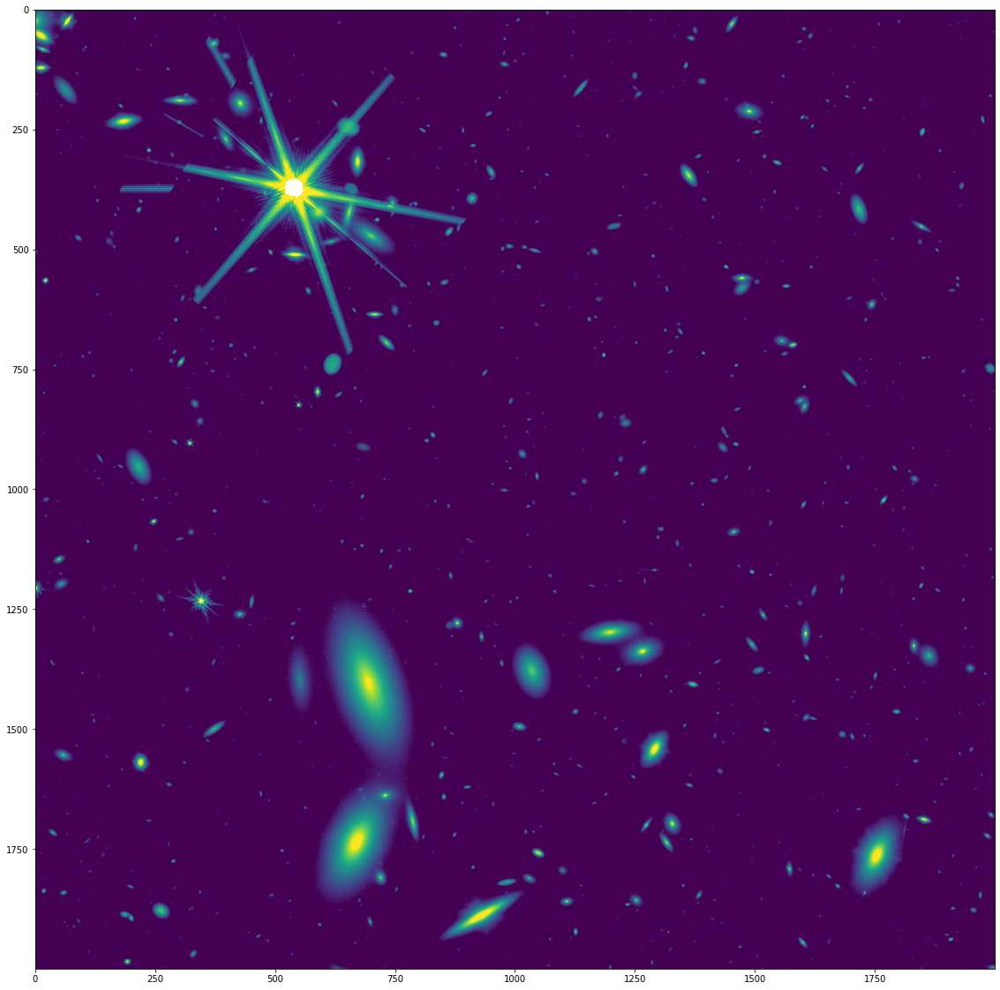

In [499]:
jql.imshow(data_flux_F277W,fnx=20,fny=20,flag_log=True)

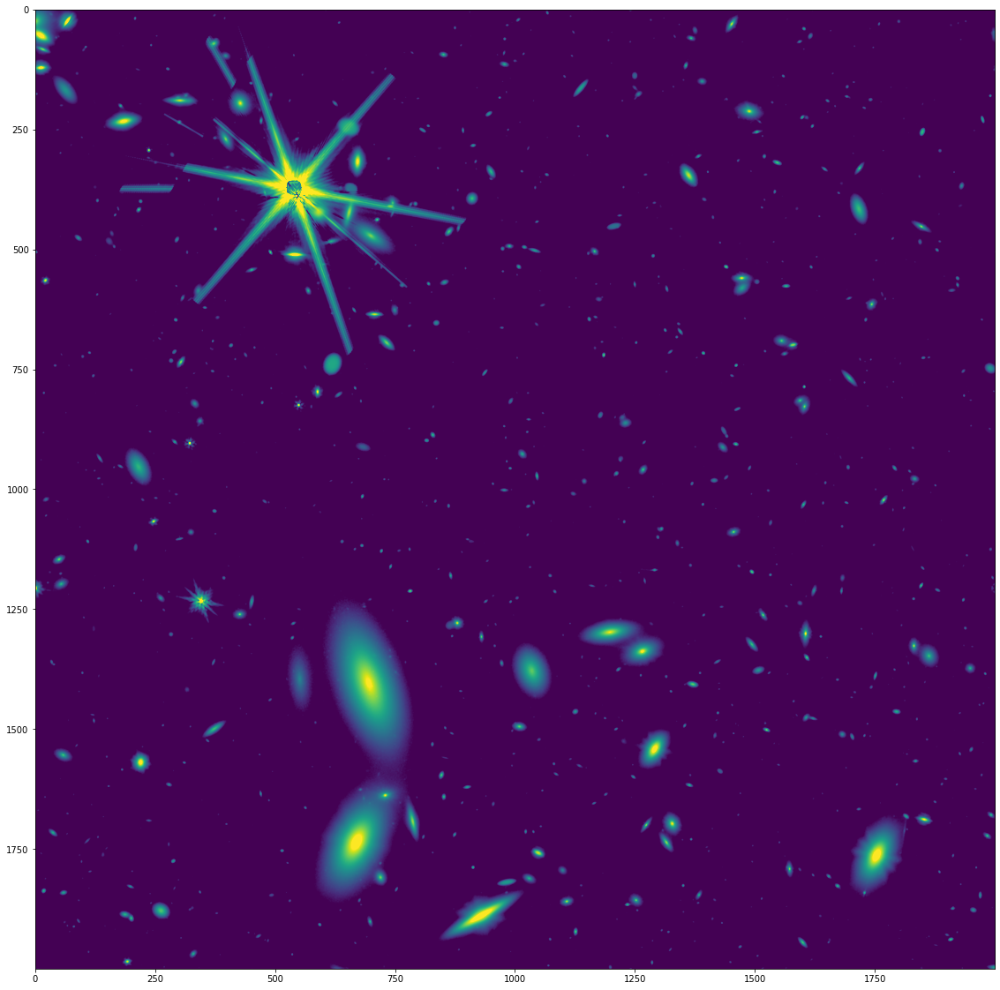

In [498]:
jql.imshow(data_model_F277W,fnx=20,fny=20,flag_log=True)

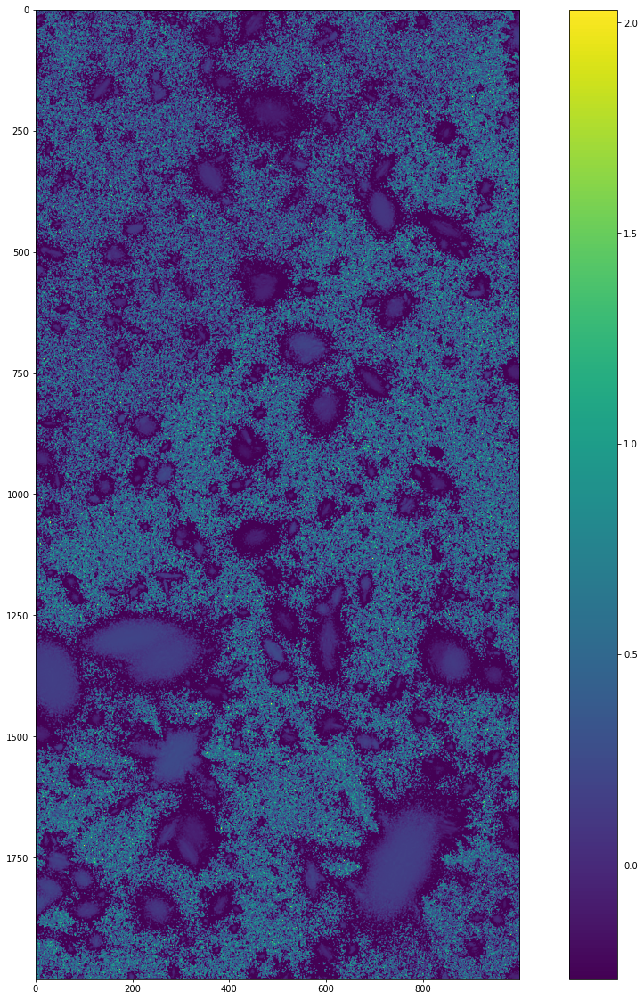

In [519]:
jql.imshow(data_model_F277W[:,1000:]/data_model_F356W[:,1000:],fnx=20,fny=20,flag_log=True)
plt.colorbar()

### Repeat for F444W

### Get the F444W PSF

In [520]:
nc.filter = 'F444W'
hdu_F444W = nc.calc_psf(detector_oversample=1,fft_oversample=4,fov_arcsec=50.0)
psf_F444W = hdu_F444W[0].data
print(psf_F444W.shape)

(794, 794)


### Rotate the F444W PSF

In [532]:
psf_F444W_rotated = rotate(psf_F444W,angle=PA)

### Plot the rotated PSF

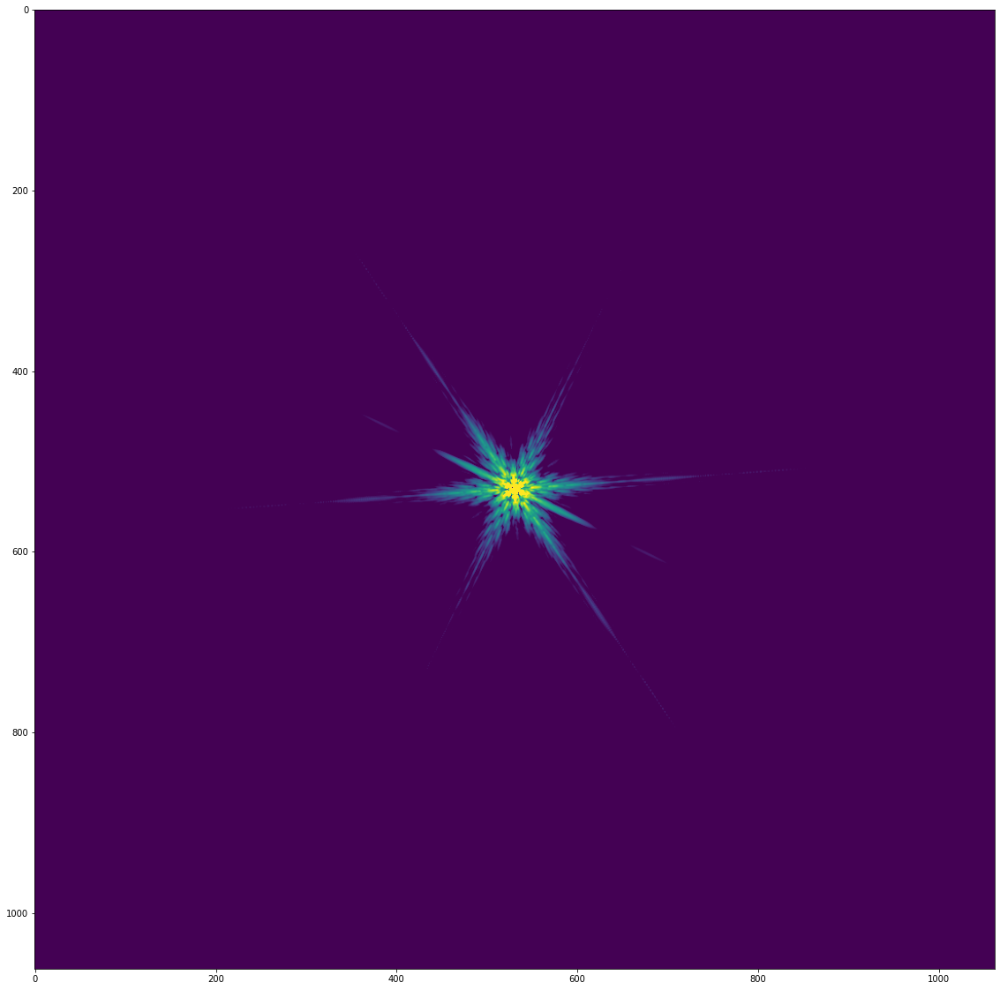

In [533]:
jql.imshow(psf_F444W_rotated,fnx=20,fny=20,flag_log=True)

### Load the F444W Image

In [524]:
#Now do with F444W
fdir_F444W = fdir_dc2+"F444W/"

In [525]:
#Get flux image file names
fname_F444W_flux_fits = fdir_F444W+"F444W.fits"
fname_F444W_ferr_fits = fdir_F444W+"F444W_err.fits"

In [526]:
#read in flux images
hdu_F444W_flux = fits.open(fname_F444W_flux_fits)
hdu_F444W_ferr = fits.open(fname_F444W_ferr_fits)

In [527]:
#get the data from the HDU
data_F444W_flux = hdu_F444W_flux[0].data
data_F444W_ferr = hdu_F444W_ferr[0].data

In [528]:
#make some cutouts

xmin = 6000
xmax = 8000
ymin = 6000
ymax = 8000
data_flux_F444W = jql.cutout(data_F444W_flux,xmin,xmax,ymin,ymax)
data_ferr_F444W = jql.cutout(data_F444W_ferr,xmin,xmax,ymin,ymax)

In [485]:
#byte swap
data_flux_F444W = data_flux_F444W.byteswap(inplace=True).newbyteorder()
data_ferr_F444W = data_ferr_F444W.byteswap(inplace=True).newbyteorder()

### Perform the iterative masking of sources

In [487]:
mask_F444W, objects_F444W = iterative_detect_and_mask(data_flux_F444W)

### Compute the mean background using the masked image

In [529]:
data_flux_masked = data_flux_F444W.copy()
data_flux_masked[mask==True] = np.nan

In [530]:
data_flux_bkg = np.nanmean(data_flux_masked)

print(f"Background level = {data_flux_bkg}")

Background level = 0.02525072731077671


### Subtract a constant background

In [531]:
data_flux_sub = data_flux_F444W.copy() - data_flux_bkg

In [534]:
data_flux_sub_F444W = data_flux_sub.copy()

In [536]:
data_flux_sub_masked = data_flux_sub.copy()
data_flux_sub_masked[mask==True] = np.nan
data_flux_sub_bkg = np.nanmean(data_flux_sub_masked)
print(f"Background level after constant background subtraction = {data_flux_sub_bkg}")
variance_data_flux_sub = np.nanvar(data_flux_sub_masked)
print(f"Background variance = {variance_data_flux_sub}.")

Background level after constant background subtraction = 9.17314491033494e-09
Background variance = 0.027530433610081673.


### Perform the convolution

In [537]:
psf_rot = psf_F444W_rotated.copy()
signal = data_flux_sub_F444W.copy()
kernel = np.zeros_like(signal)
pkernel = np.zeros_like(signal)


#NIRCam PSF kernel
nkx = psf_rot.shape[0]
nky = psf_rot.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
kernel[iko:iko+nkx,jko:jko+nky] += psf_rot.copy()

#Model output PSF
pred_kernel = psf_pred.copy()
pred_kernel/=np.sum(pred_kernel)
nkx = pred_kernel.shape[0]
nky = pred_kernel.shape[1]
iko = int(0.5*signal.shape[0] - 0.5*nkx)
jko = int(0.5*signal.shape[1] - 0.5*nky)
pkernel[iko:iko+nkx,jko:jko+nky] += pred_kernel


#Avoid any nasty nans
idx = np.where(np.isnan(signal))
signal[idx] = 0


#perform Wiener deconvolution w/ convolution to final PSF
H = np.fft.fft2(kernel)
data_model_F444W = np.real(np.fft.ifft2(np.fft.fft2(pkernel)*np.fft.fft2(signal)*np.conj(H)/(np.absolute(H)**2 + variance_data_flux_sub)))

### Show the F444W model image

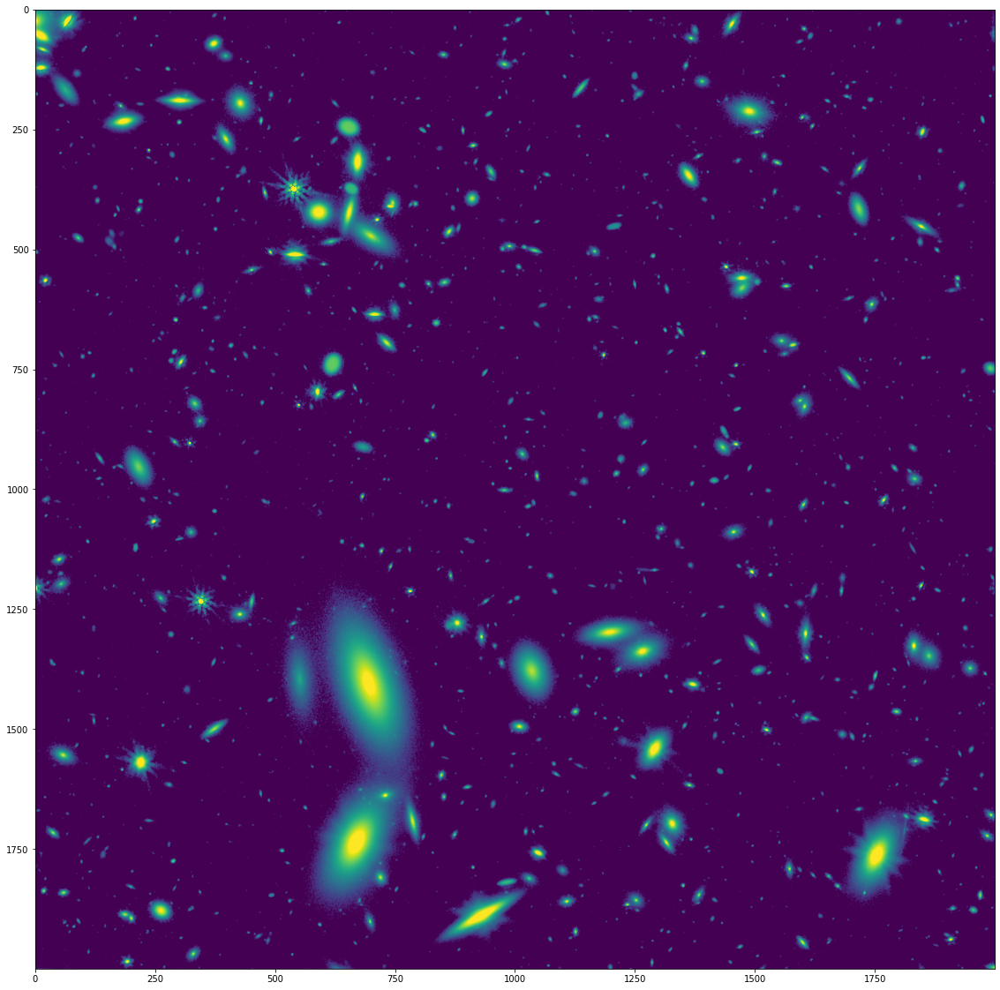

In [538]:
jql.imshow(data_model_F444W,fnx=20,fny=20,flag_log=True)

### Plot the stacked LW image

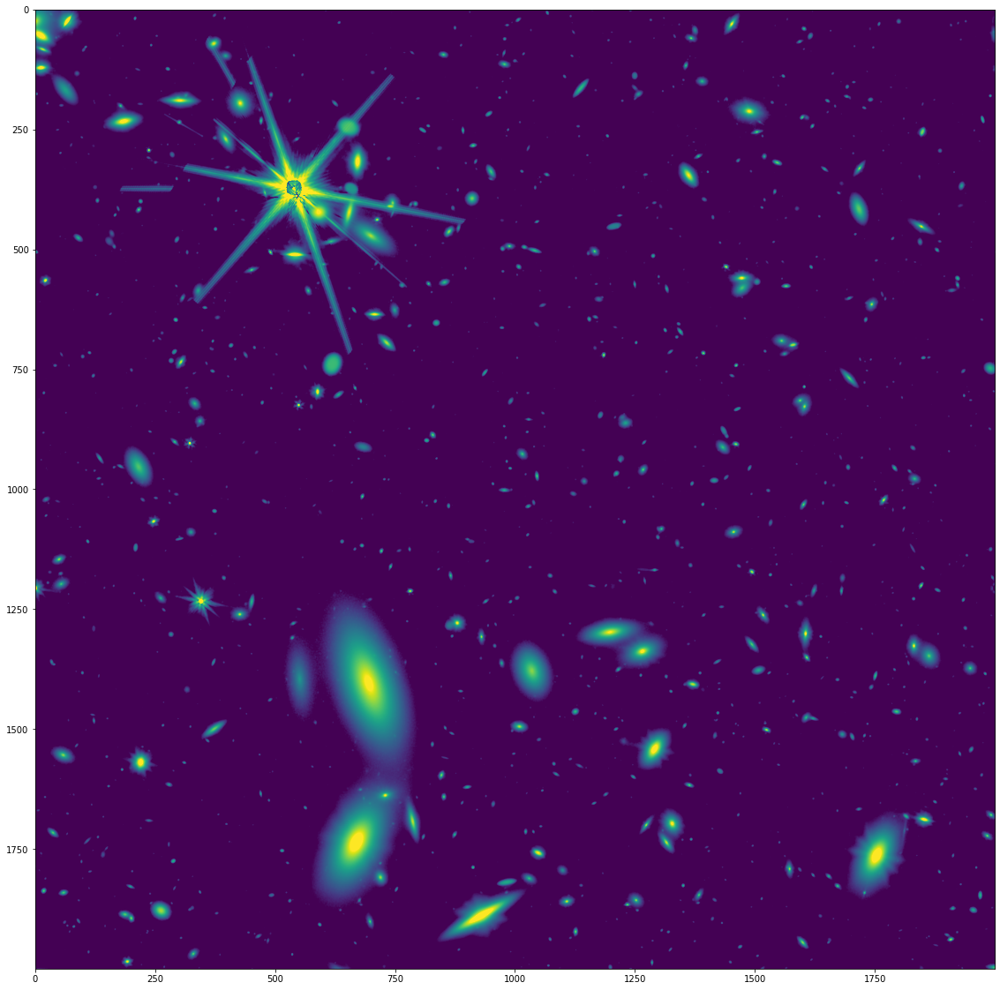

In [539]:
jql.imshow(data_model_F277W+data_model_F356W+data_model_F444W,fnx=20,fny=20,flag_log=True)

## 6) Repeat for variance images?